# Data Simulation

In this notebook data is simulated based on Nuc/Cyt model and veloVI is fitted on this data.

**Requires:**
To be able to run the notebook
- the nuc/cyt model in scvelo/inference/* and
- datasets/_simulate and
- core/_models needs to be implemented

**Output:** Rate parameter ratio plots

## Library imports

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import sys

import mplscience

import numpy as np
import pandas as pd
from scipy.stats import pearsonr, spearmanr, ttest_ind

import matplotlib.pyplot as plt
import seaborn as sns

import scvelo as scv
from scvelo.core import NucCytModel
from scvelo.datasets import Simulator
from scvelo.inference import fit_velovi

sys.path.append("../..")
from paths import FIG_DIR  # isort: skip  # noqa: E402

/vol/storage/miniconda3/envs/conda_env_robin/lib/python3.9/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/vol/storage/miniconda3/envs/conda_env_robin/lib/python3.9/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/vol/storage/miniconda3/envs/conda_env_robin/lib/pyt

## Function definitions

In [109]:
def _get_significance(pvalue):
    if pvalue < 0.001:
        return "***"
    elif pvalue < 0.01:
        return "**"
    elif pvalue < 0.1:
        return "*"
    else:
        return "n.s."

In [110]:
def _add_significance(ax, left: int, right: int, significance: str, level: int = 0, **kwargs):
    bracket_level = kwargs.pop("bracket_level", 1)
    bracket_height = kwargs.pop("bracket_height", 0.02)
    text_height = kwargs.pop("text_height", 0.01)

    bottom, top = ax.get_ylim()
    y_axis_range = top - bottom

    bracket_level = (y_axis_range * 0.07 * level) + top * bracket_level
    bracket_height = bracket_level - (y_axis_range * bracket_height)

    ax.plot([left, left, right, right], [bracket_height, bracket_level, bracket_level, bracket_height], **kwargs)

    ax.text(
        (left + right) * 0.5,
        bracket_level + (y_axis_range * text_height),
        significance,
        ha="center",
        va="bottom",
        c="k",
    )

## General Settings

In [77]:
SAVE_FIGURES = True
n_obs = 25000
n_vars = 1000
t_max = 20

## Definition of parameters for log-normal distribution of kinetic parameters

In [78]:
# define mean and covariance matrix for rate parameters alpha, beta, nu, gamma
mu = np.array([2, 1, 0.5, 0.1])

R = np.array([[1.0, 0.8, 0.5, 0.2], [0.8, 1.0, 0.8, 0.5], [0.5, 0.8, 1.0, 0.8], [0.2, 0.5, 0.8, 1]])

C = np.array([0.4, 0.4, 0.4, 0.4])[:, None]

cov = C.dot(C.T) * R


alpha, beta, nu, gamma = np.exp(np.random.multivariate_normal(mu, cov, size=n_vars).T)  # multivariate log-normal

# remove outliers
idx = (
    (alpha < np.percentile(alpha, 99))
    & (beta < np.percentile(beta, 99))
    & (gamma < np.percentile(gamma, 99))
    & (nu < np.percentile(nu, 99))
)
alpha = alpha[idx]
beta = beta[idx]
nu = nu[idx]
gamma = gamma[idx]

n_vars = np.sum(idx)

## Data Simulator

In [79]:
# Define switches s.t. switching_times are then in [0.1*t_max, 0.5*t_max]
switches = np.random.uniform(0.1, 0.5, size=n_vars)
simulator = Simulator(
    cell_gene_time=False,
    n_obs=n_obs,
    n_vars=n_vars,
    t_final=t_max,
    switches=switches,
    time_distribution="uniform",
    noise_level=0.8,
)

# Get AnnData object

In [80]:
adata = simulator.fit(
    NucCytModel,
    layer_names=["unspliced_nucleus", "spliced_nucleus", "spliced_cytosol"],
    transcription_rate=alpha,
    nuc_export_rate=nu,
    splicing_rate=beta,
    degradation_rate=gamma,
    transcription_rate_=0,
    initial_state=[0, 0, 0],
)

adata

AnnData object with n_obs × n_vars = 25000 × 974
    obs: 'true_t'
    var: 'true_t_', 'true_scaling', 'true_transcription_rate', 'true_nuc_export_rate', 'true_splicing_rate', 'true_degradation_rate'
    layers: 'unspliced_nucleus', 'spliced_nucleus', 'spliced_cytosol'

## Fit veloVI Model

In [81]:
vae, adata = fit_velovi(
    adata,
    max_epochs=500,
    unspliced_layer_nuc="unspliced_nucleus",
    spliced_layer_nuc="spliced_nucleus",
    spliced_layer_cyt="spliced_cytosol",
    lr=5e-3,
)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 169/500:  34%|████        | 169/500 [10:44<21:02,  3.81s/it, v_num=1, train_loss_step=-106, train_loss_epoch=-236]
Monitored metric elbo_validation did not improve in the last 45 records. Best score: -285.564. Signaling Trainer to stop.


### Plot ELBO loss

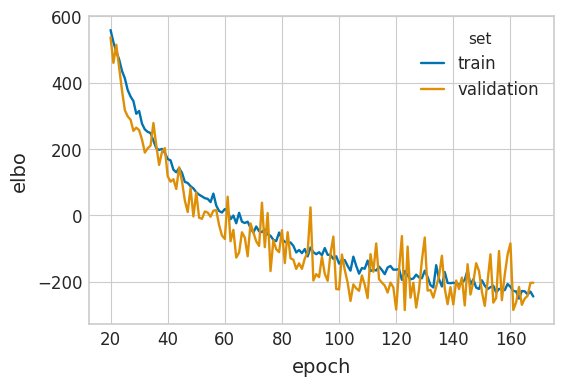

In [82]:
df = vae.history["elbo_train"].iloc[20:].reset_index().rename(columns={"elbo_train": "elbo"})
df["set"] = "train"

_df = vae.history["elbo_validation"].iloc[20:].reset_index().rename(columns={"elbo_validation": "elbo"})
_df["set"] = "validation"

df = pd.concat([df, _df], axis=0).reset_index(drop=True)

with mplscience.style_context():
    sns.set_style(style="whitegrid")
    fig, ax = plt.subplots(figsize=(6, 4))
    sns.lineplot(data=df, x="epoch", y="elbo", hue="set", palette=["#0173B2", "#DE8F05"], ax=ax)
    plt.show()

## Define true and inferred kinetic ratios

In [83]:
adata.var["vi_ratio_gamma_beta"] = adata.var["fit_gamma"] / adata.var["fit_beta"]
adata.var["true_ratio_gamma_beta"] = np.array(adata.var.true_degradation_rate / adata.var.true_splicing_rate)

adata.var["vi_ratio_gamma_nu"] = adata.var["fit_gamma"] / adata.var["fit_nu"]
adata.var["true_ratio_gamma_nu"] = np.array(adata.var.true_degradation_rate / adata.var.true_nuc_export_rate)

adata.var["vi_ratio_alpha_beta"] = adata.var["fit_alpha"] / adata.var["fit_beta"]
adata.var["true_ratio_alpha_beta"] = np.array(adata.var.true_transcription_rate / adata.var.true_splicing_rate)

adata.var["vi_ratio_nu_beta"] = adata.var["fit_nu"] / adata.var["fit_beta"]
adata.var["true_ratio_nu_beta"] = np.array(adata.var.true_nuc_export_rate / adata.var.true_splicing_rate)

adata.var["vi_ratio_alpha_nu"] = adata.var["fit_alpha"] / adata.var["fit_nu"]
adata.var["true_ratio_alpha_nu"] = np.array(adata.var.true_transcription_rate / adata.var.true_nuc_export_rate)

adata.var["vi_ratio_alpha_gamma"] = adata.var["fit_alpha"] / adata.var["fit_gamma"]
adata.var["true_ratio_alpha_gamma"] = np.array(adata.var.true_transcription_rate / adata.var.true_degradation_rate)

### Pearson Correlation of true and inferred kinetic ratios


In [283]:
print(
    "Pearson correlation of inferred and true ratio of nuclear export and splicing rate:",
    pearsonr(adata.var["vi_ratio_nu_beta"], adata.var["true_ratio_nu_beta"]),
    "\n",
)

print(
    "Pearson correlation of inferred and true ratio of degradation and splicing rate:",
    pearsonr(adata.var["vi_ratio_gamma_beta"], adata.var["true_ratio_gamma_beta"]),
    "\n",
)

print(
    "Pearson correlation of inferred and true ratio of degradation and nuclear export rate:",
    pearsonr(adata.var["vi_ratio_gamma_nu"], adata.var["true_ratio_gamma_nu"]),
    "\n",
)

print(
    "Pearson correlation of inferred and true ratio of transcription and splicing rate:",
    pearsonr(adata.var["vi_ratio_alpha_beta"], adata.var["true_ratio_alpha_beta"]),
    "\n",
)

print(
    "Pearson correlation of inferred and true ratio of transcription and nuclear export rate:",
    pearsonr(adata.var["vi_ratio_alpha_nu"], adata.var["true_ratio_alpha_nu"]),
    "\n",
)

print(
    "Pearson correlation of inferred and true ratio of transcription and degradation rate:",
    pearsonr(adata.var["vi_ratio_alpha_gamma"], adata.var["true_ratio_alpha_gamma"]),
    "\n",
)

Pearson correlation of inferred and true ratio of nuclear export and splicing rate: PearsonRResult(statistic=0.9835513045905049, pvalue=0.0) 

Pearson correlation of inferred and true ratio of degradation and splicing rate: PearsonRResult(statistic=0.9306601083721542, pvalue=0.0) 

Pearson correlation of inferred and true ratio of degradation and nuclear export rate: PearsonRResult(statistic=0.913957766638346, pvalue=0.0) 

Pearson correlation of inferred and true ratio of transcription and splicing rate: PearsonRResult(statistic=0.9992339471697973, pvalue=0.0) 

Pearson correlation of inferred and true ratio of transcription and nuclear export rate: PearsonRResult(statistic=0.994137993053811, pvalue=0.0) 

Pearson correlation of inferred and true ratio of transcription and degradation rate: PearsonRResult(statistic=0.9529934002758537, pvalue=0.0) 



## Plot of true vs. inferred ratios

#### Degradation/ nuclear export rate ratio


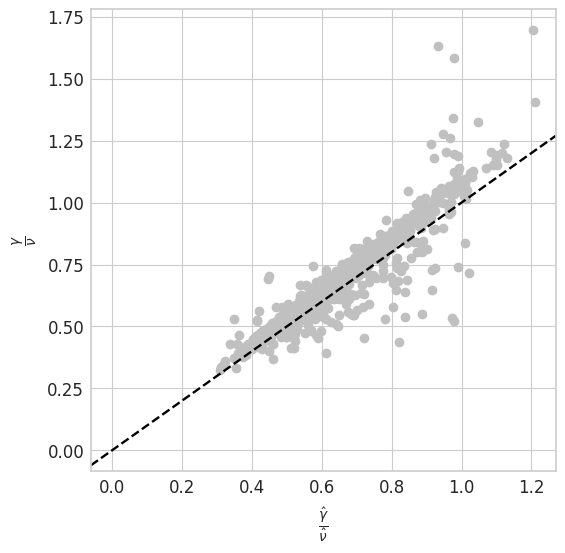

In [284]:
with mplscience.style_context():
    sns.set_style(style="whitegrid")
    fig, ax = plt.subplots(figsize=(6, 6))
    ax.axline((0, 0), slope=1, color="black", linestyle="--")

    ax.set_xlabel(r"$\frac{\hat{\gamma}}{\hat{\nu}}$")
    ax.set_ylabel(r"$\frac{\gamma}{\nu}$")

    ax.scatter(
        y=adata.var["true_ratio_gamma_nu"],
        x=adata.var["vi_ratio_gamma_nu"],
        c="silver",
    )
    plt.show()

if SAVE_FIGURES:
    path = FIG_DIR / "data_simulation" / "rate_parameter_ratios"
    path.mkdir(parents=True, exist_ok=True)
    fig.savefig(path / "ratio_gamma_nu.svg", format="svg", transparent=True, bbox_inches="tight")

#### Nuclear export/ splicing rate ratio

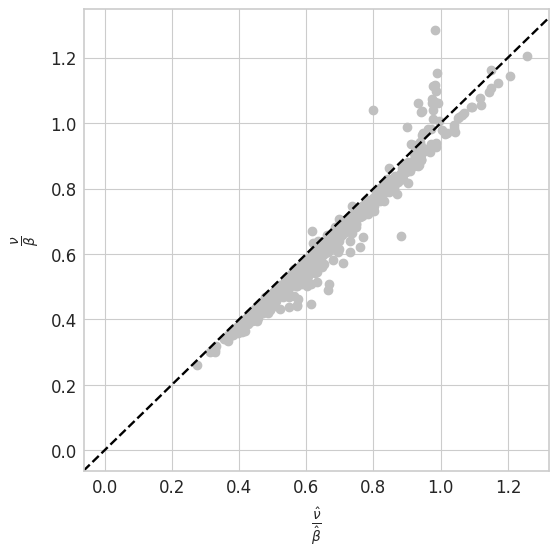

In [285]:
with mplscience.style_context():
    sns.set_style(style="whitegrid")
    fig, ax = plt.subplots(figsize=(6, 6))
    ax.axline((0, 0), slope=1, color="black", linestyle="--")

    ax.set_xlabel(r"$\frac{\hat{\nu}}{\hat{\beta}}$")
    ax.set_ylabel(r"$\frac{\nu}{\beta}$")

    ax.scatter(
        y=adata.var["true_ratio_nu_beta"],
        x=adata.var["vi_ratio_nu_beta"],
        c="silver",
    )
    plt.show()

if SAVE_FIGURES:
    path = FIG_DIR / "data_simulation" / "rate_parameter_ratios"
    path.mkdir(parents=True, exist_ok=True)
    fig.savefig(path / "ratio_nu_beta.svg", format="svg", transparent=True, bbox_inches="tight")

#### Degradation/ splicing rate ratio

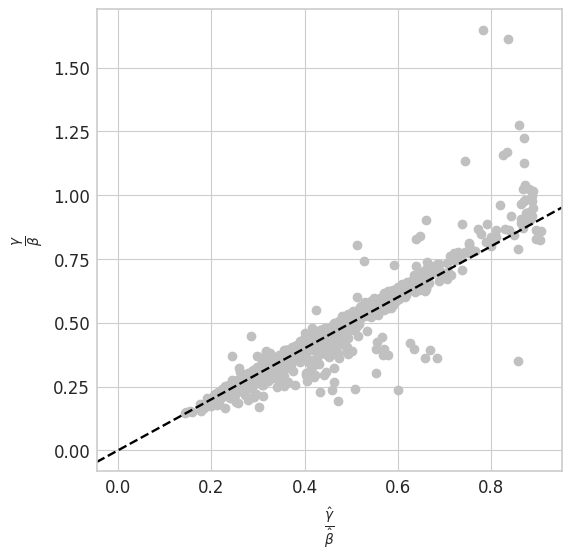

In [286]:
with mplscience.style_context():
    sns.set_style(style="whitegrid")
    fig, ax = plt.subplots(figsize=(6, 6))
    ax.axline((0, 0), slope=1, color="black", linestyle="--")

    ax.set_xlabel(r"$\frac{\hat{\gamma}}{\hat{\beta}}$")
    ax.set_ylabel(r"$\frac{\gamma}{\beta}$")

    ax.scatter(
        y=adata.var["true_ratio_gamma_beta"],
        x=adata.var["vi_ratio_gamma_beta"],
        c="silver",
    )
    plt.show()

if SAVE_FIGURES:
    path = FIG_DIR / "data_simulation" / "rate_parameter_ratios"
    path.mkdir(parents=True, exist_ok=True)
    fig.savefig(path / "ratio_gamma_beta.svg", format="svg", transparent=True, bbox_inches="tight")

#### Transcription/ splicing rate ratio

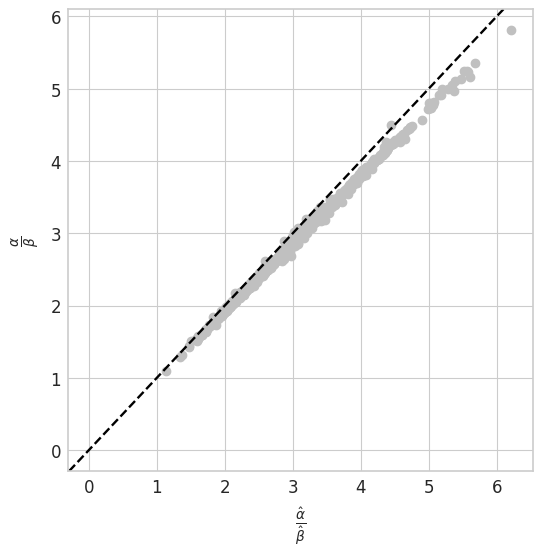

In [89]:
with mplscience.style_context():
    sns.set_style(style="whitegrid")
    fig, ax = plt.subplots(figsize=(6, 6))
    ax.axline((0, 0), slope=1, color="black", linestyle="--")

    ax.set_xlabel(r"$\frac{\hat{\alpha}}{\hat{\beta}}$")
    ax.set_ylabel(r"$\frac{\alpha}{\beta}$")

    ax.scatter(
        y=adata.var["true_ratio_alpha_beta"],
        x=adata.var["vi_ratio_alpha_beta"],
        c="silver",
    )
    plt.show()

if SAVE_FIGURES:
    path = FIG_DIR / "data_simulation" / "rate_parameter_ratios"
    path.mkdir(parents=True, exist_ok=True)
    fig.savefig(path / "ratio_alpha_beta.svg", format="svg", transparent=True, bbox_inches="tight")

#### Transcription/ nuclear export rate ratio

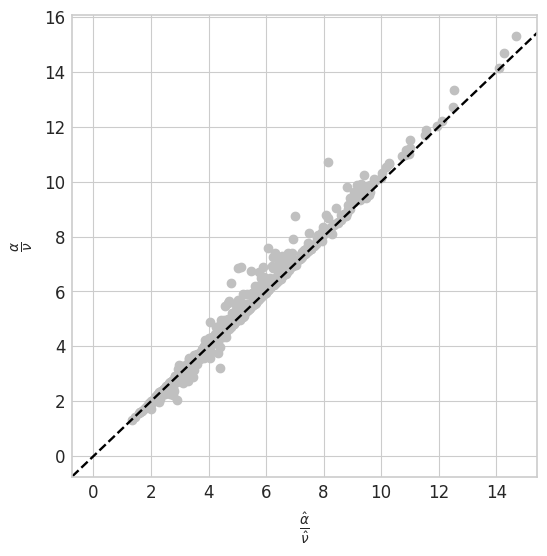

In [90]:
with mplscience.style_context():
    sns.set_style(style="whitegrid")
    fig, ax = plt.subplots(figsize=(6, 6))
    ax.axline((0, 0), slope=1, color="black", linestyle="--")

    ax.set_xlabel(r"$\frac{\hat{\alpha}}{\hat{\nu}}$")
    ax.set_ylabel(r"$\frac{\alpha}{\nu}$")

    ax.scatter(
        y=adata.var["true_ratio_alpha_nu"],
        x=adata.var["vi_ratio_alpha_nu"],
        c="silver",
    )
    plt.show()

if SAVE_FIGURES:
    path = FIG_DIR / "data_simulation" / "rate_parameter_ratios"
    path.mkdir(parents=True, exist_ok=True)
    fig.savefig(path / "ratio_alpha_nu.svg", format="svg", transparent=True, bbox_inches="tight")

#### Transcription/ degradation rate ratio


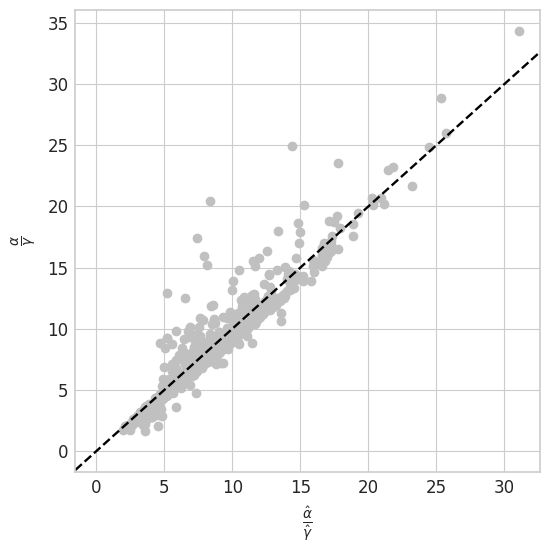

In [91]:
with mplscience.style_context():
    sns.set_style(style="whitegrid")
    fig, ax = plt.subplots(figsize=(6, 6))
    ax.axline((0, 0), slope=1, color="black", linestyle="--")

    ax.set_xlabel(r"$\frac{\hat{\alpha}}{\hat{\gamma}}$")
    ax.set_ylabel(r"$\frac{\alpha}{\gamma}$")

    ax.scatter(
        y=adata.var["true_ratio_alpha_gamma"],
        x=adata.var["vi_ratio_alpha_gamma"],
        c="silver",
    )
    plt.show()

if SAVE_FIGURES:
    path = FIG_DIR / "data_simulation" / "rate_parameter_ratios"
    path.mkdir(parents=True, exist_ok=True)
    fig.savefig(path / "ratio_alpha_gamma.svg", format="svg", transparent=True, bbox_inches="tight")

### Plot all rate parameter ratios, where on x axis all inferred ratios are stacked together and on y axis all true ratios are stacked together

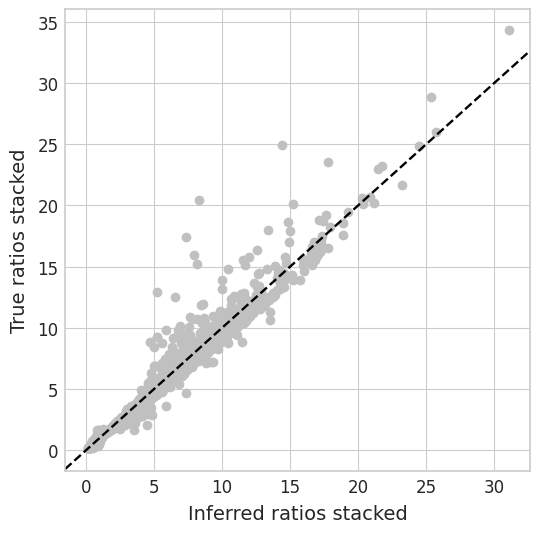

In [217]:
# get vars of vi and true to stack them together for plot
vi_ratio_vars = []
true_ratio_vars = []
for var in adata.var.columns:
    if var.startswith("vi_ratio"):
        true_ratio_var = "true_ratio" + var.split("vi_ratio")[1]
        vi_ratio_vars.append(var)
        true_ratio_vars.append(true_ratio_var)

y = np.concatenate([adata.var[true_ratios] for true_ratios in true_ratio_vars])
x = np.concatenate([adata.var[vi_ratios] for vi_ratios in vi_ratio_vars])


with mplscience.style_context():
    sns.set_style(style="whitegrid")
    fig, ax = plt.subplots(figsize=(6, 6))
    ax.axline((0, 0), slope=1, color="black", linestyle="--")

    ax.set_xlabel("Inferred ratios stacked")
    ax.set_ylabel("True ratios stacked")

    ax.scatter(
        y=y,
        x=x,
        c="silver",
    )
    plt.show()

if SAVE_FIGURES:
    path = FIG_DIR / "data_simulation" / "rate_parameter_ratios"
    path.mkdir(parents=True, exist_ok=True)
    fig.savefig(path / "all_ratios_stacked.svg", format="svg", transparent=True, bbox_inches="tight")

## Zoom into genes where ratio is far off standard diagonal
E.g. we calculate the 99th percentile and consider genes which are far off standard diagonal

### 1. Phase portraits colored by inferred latent times

In [277]:
# add Mu_nuc, Ms_nuc, Ms_cyt layers for plotting purposes
adata.layers["Mu_nuc"] = adata.layers["unspliced_nucleus"]
adata.layers["Ms_nuc"] = adata.layers["spliced_nucleus"]
adata.layers["Ms_cyt"] = adata.layers["spliced_cytosol"]
adata.layers["fit_t"] = vae.get_latent_time_with_rep_ss(n_samples=25)

scaling = 20 / adata.layers["fit_t"].max(0)
adata.layers["fit_t"] = adata.layers["fit_t"] * scaling

# define L1 distance of ratio deviations and select >99 percentile
ratio_deviation_1 = np.abs(np.array(adata.var["true_ratio_gamma_beta"] - adata.var["vi_ratio_gamma_beta"]))
ratio_deviation_2 = np.abs(np.array(adata.var["true_ratio_gamma_nu"] - adata.var["vi_ratio_gamma_nu"]))
ratio_deviation_3 = np.abs(np.array(adata.var["true_ratio_alpha_beta"] - adata.var["vi_ratio_alpha_beta"]))
ratio_deviation_4 = np.abs(np.array(adata.var["true_ratio_nu_beta"] - adata.var["vi_ratio_nu_beta"]))
ratio_deviation_5 = np.abs(np.array(adata.var["true_ratio_alpha_nu"] - adata.var["vi_ratio_alpha_nu"]))
ratio_deviation_6 = np.abs(np.array(adata.var["true_ratio_alpha_gamma"] - adata.var["vi_ratio_alpha_gamma"]))

ad_subset = adata[
    :,
    (ratio_deviation_1 > np.percentile(ratio_deviation_1, 99))
    | (ratio_deviation_2 > np.percentile(ratio_deviation_2, 99))
    | (ratio_deviation_3 > np.percentile(ratio_deviation_3, 99))
    | (ratio_deviation_4 > np.percentile(ratio_deviation_4, 99))
    | (ratio_deviation_5 > np.percentile(ratio_deviation_5, 99))
    | (ratio_deviation_6 > np.percentile(ratio_deviation_6, 99)),
]

## Now create a plot with ratios stacked but with genes colored for thesis

In [279]:
df_ratio_stacked = pd.DataFrame({"x": x, "y": y})
df_ratio_stacked["outlier"] = (
    list(ratio_deviation_1 > np.percentile(ratio_deviation_1, 99))
    + list(ratio_deviation_2 > np.percentile(ratio_deviation_2, 99))
    + list(ratio_deviation_3 > np.percentile(ratio_deviation_3, 99))
    + list(ratio_deviation_4 > np.percentile(ratio_deviation_4, 99))
    + list(ratio_deviation_5 > np.percentile(ratio_deviation_5, 99))
    + list(ratio_deviation_6 > np.percentile(ratio_deviation_6, 99))
)

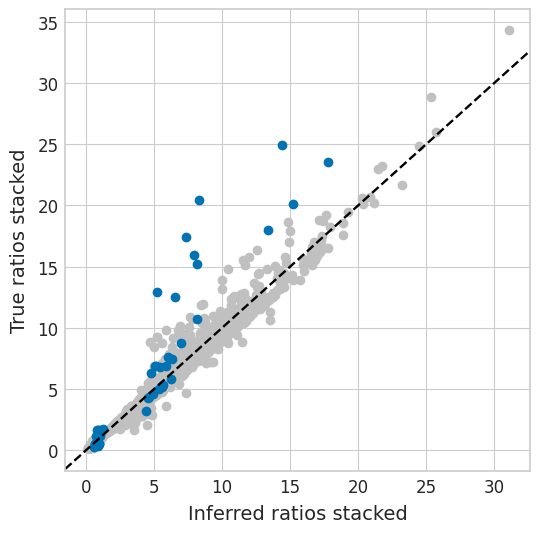

In [282]:
with mplscience.style_context():
    sns.set_style(style="whitegrid")
    fig, ax = plt.subplots(figsize=(6, 6))
    ax.axline((0, 0), slope=1, color="black", linestyle="--")

    ax.set_xlabel("Inferred ratios stacked")
    ax.set_ylabel("True ratios stacked")

    colors = {False: "silver", True: "#0173B2"}

    ax.scatter(
        df_ratio_stacked.loc[df_ratio_stacked.outlier is False, "x"],
        df_ratio_stacked.loc[df_ratio_stacked.outlier is False, "y"],
        c="silver",
    )
    ax.scatter(
        df_ratio_stacked.loc[df_ratio_stacked.outlier is True, "x"],
        df_ratio_stacked.loc[df_ratio_stacked.outlier is True, "y"],
        c="#0173B2",
    )
    plt.show()
    if SAVE_FIGURES:
        path = FIG_DIR / "data_simulation" / "rate_parameter_ratios"
        path.mkdir(parents=True, exist_ok=True)
        fig.savefig(path / "all_ratios_stacked_colored.svg", format="svg", transparent=True, bbox_inches="tight")

11


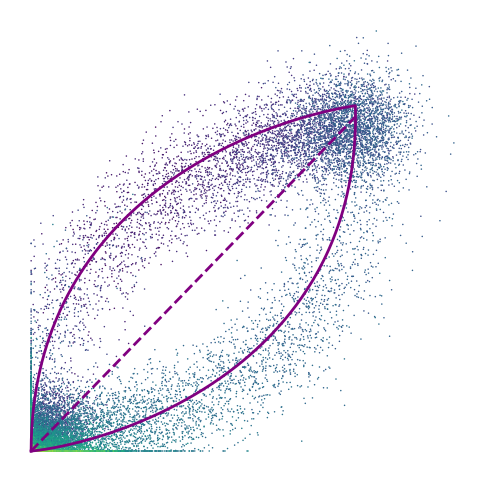

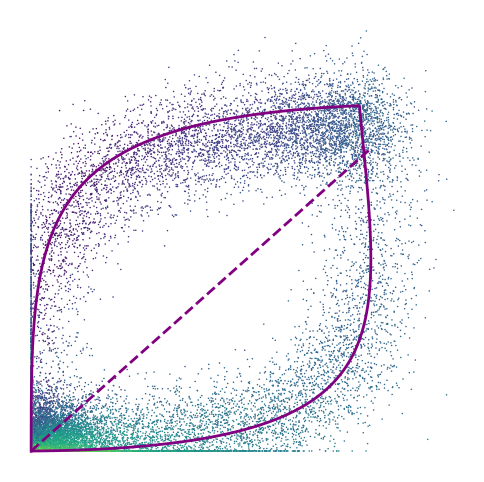

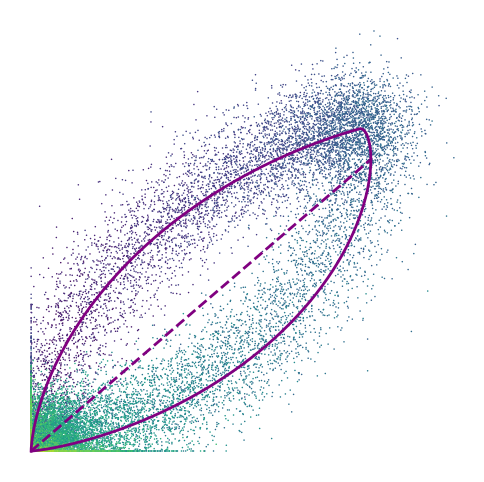

85


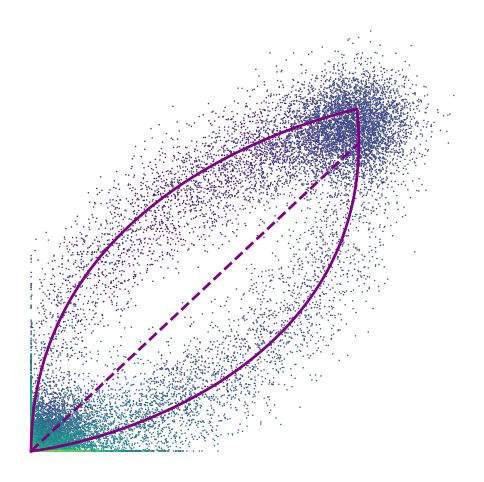

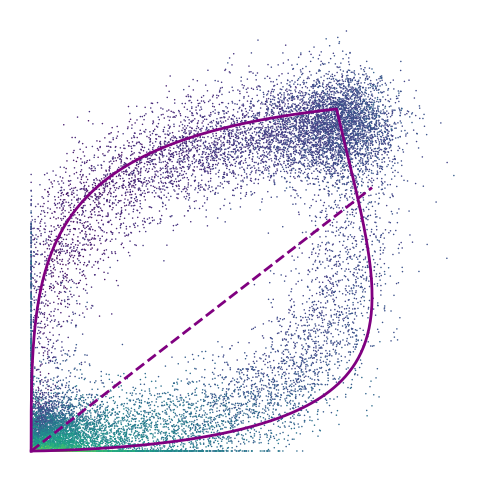

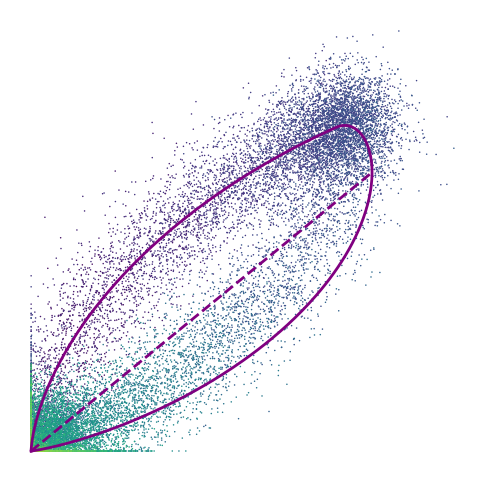

97


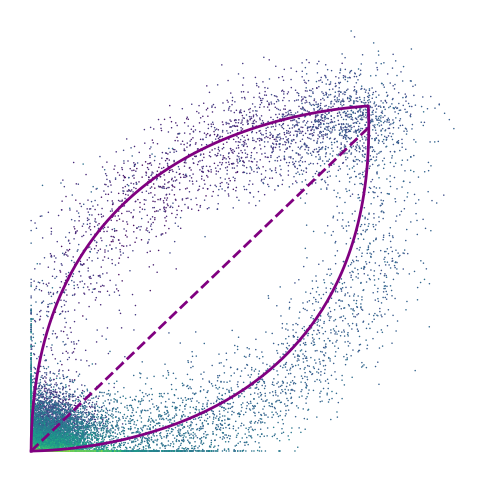

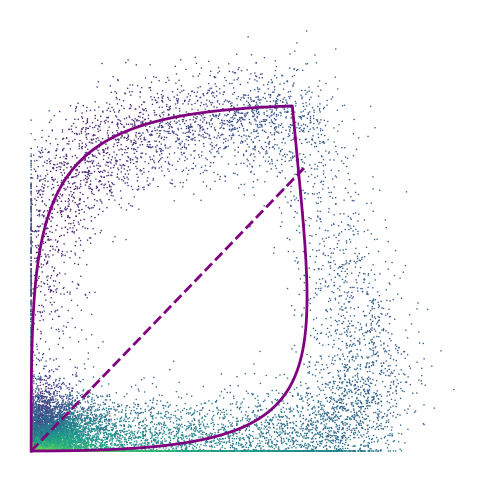

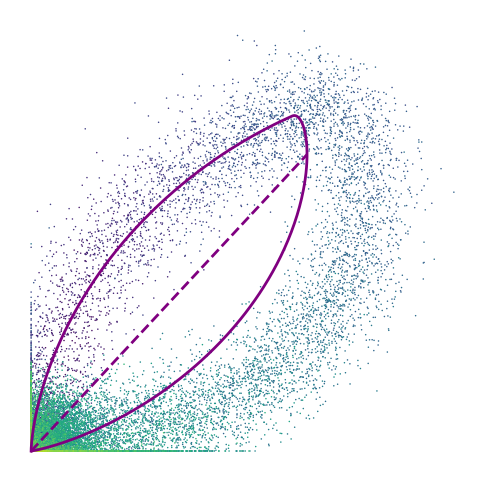

164


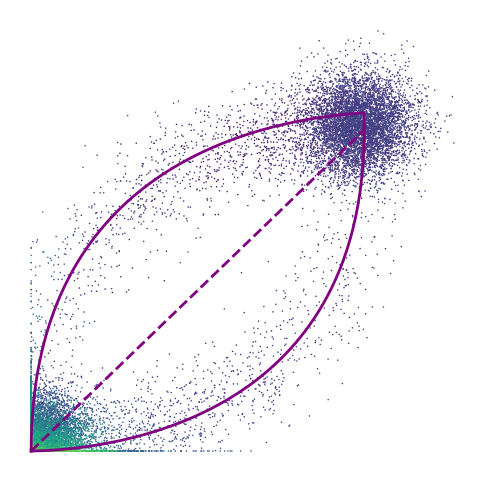

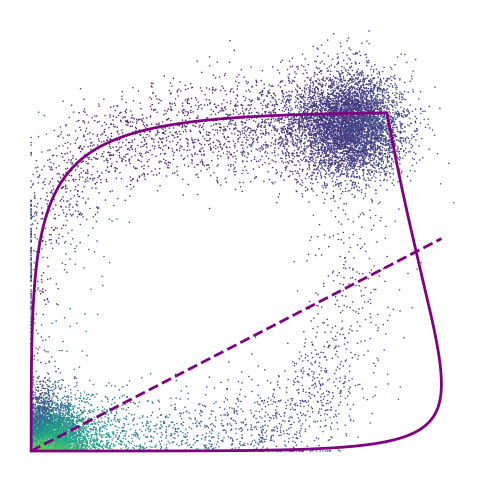

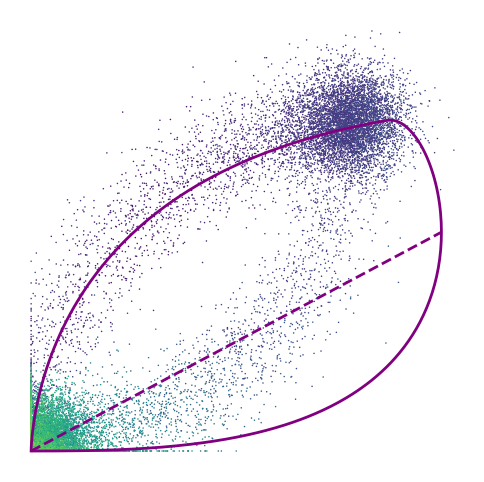

196


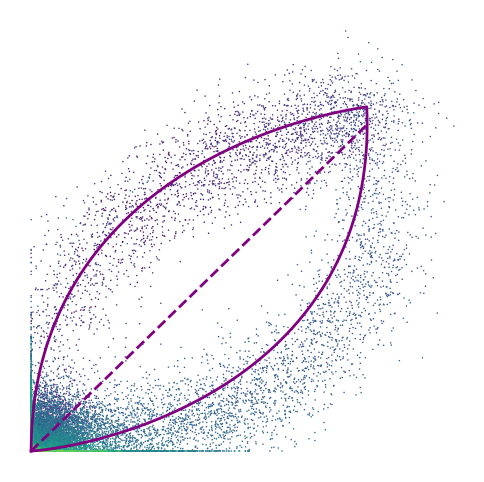

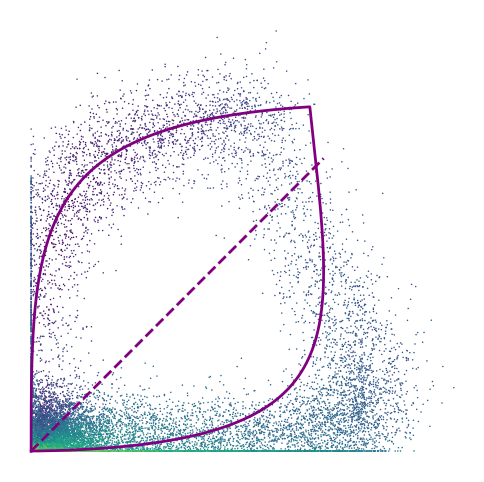

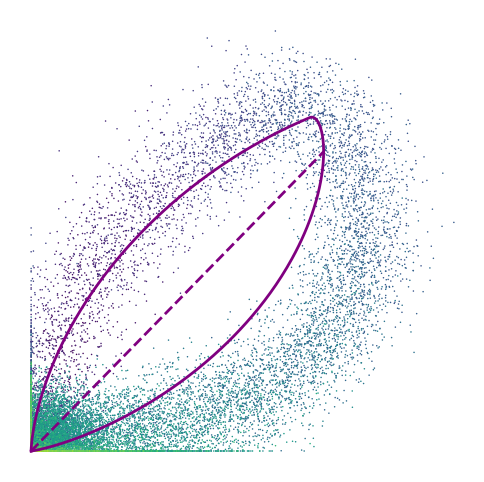

227


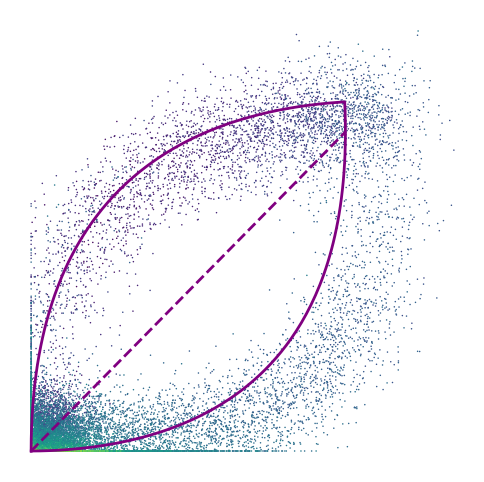

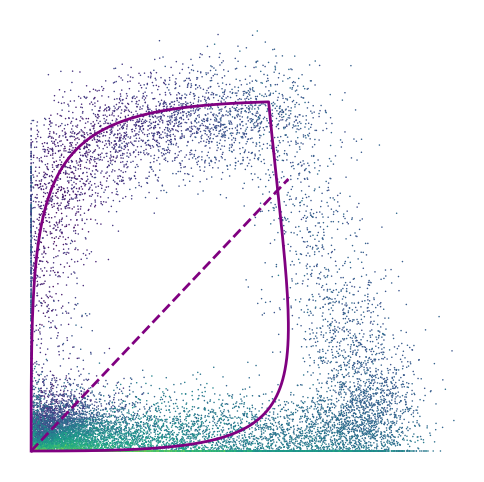

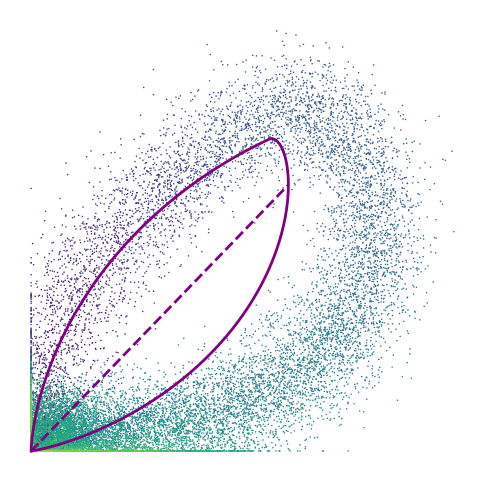

240


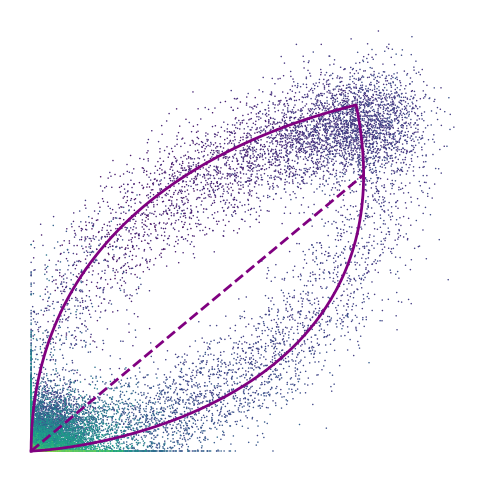

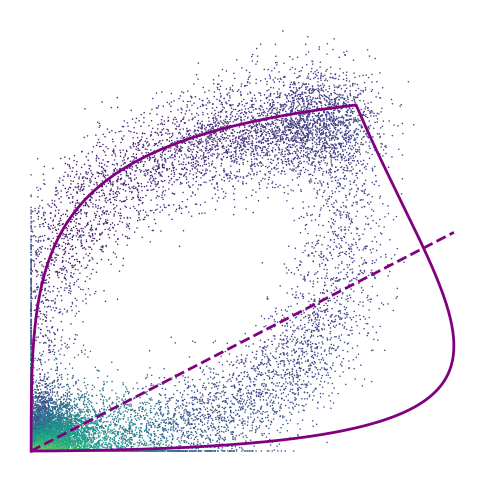

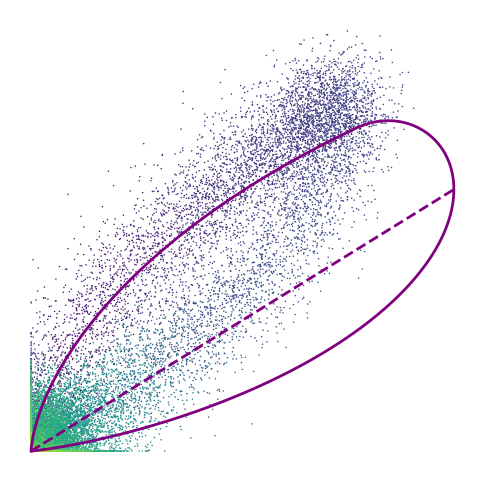

241


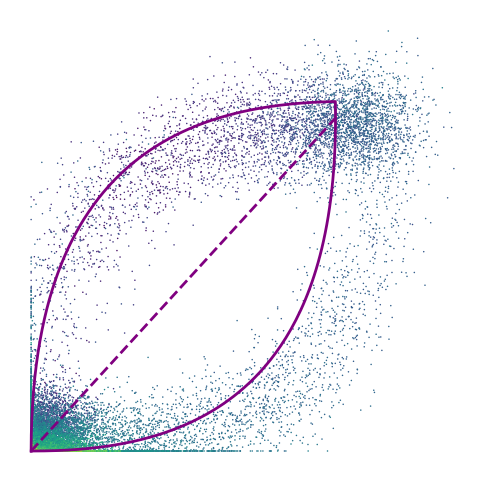

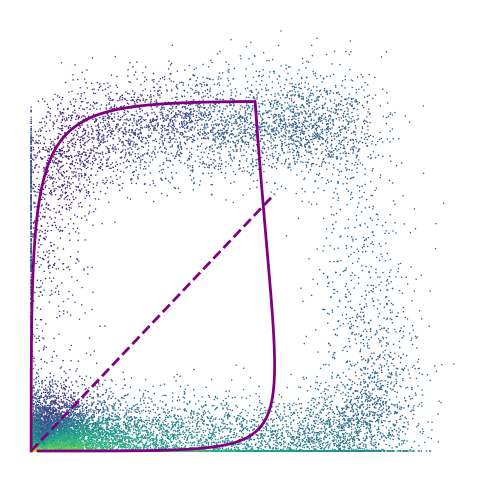

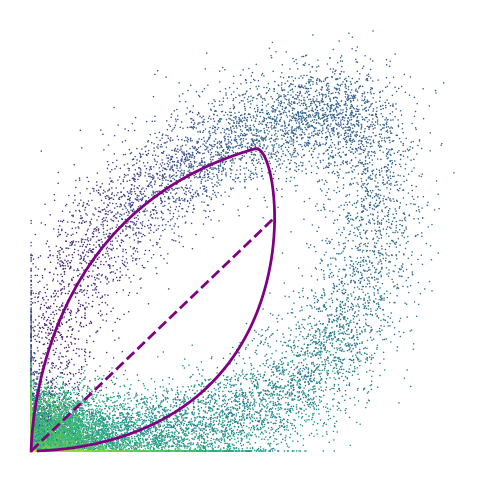

359


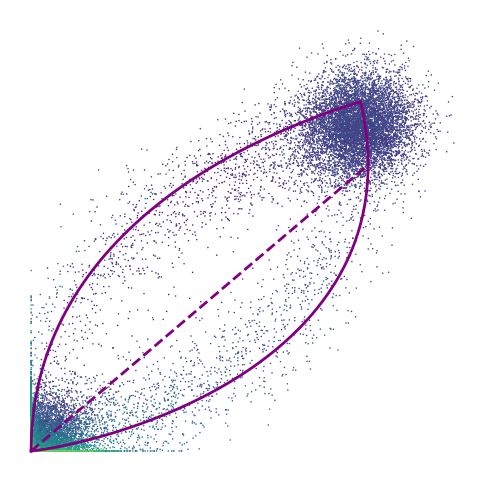

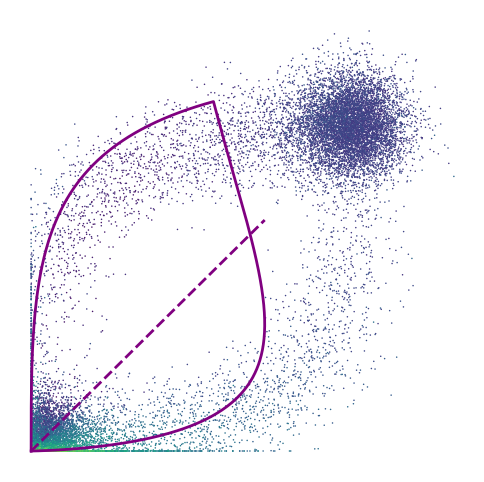

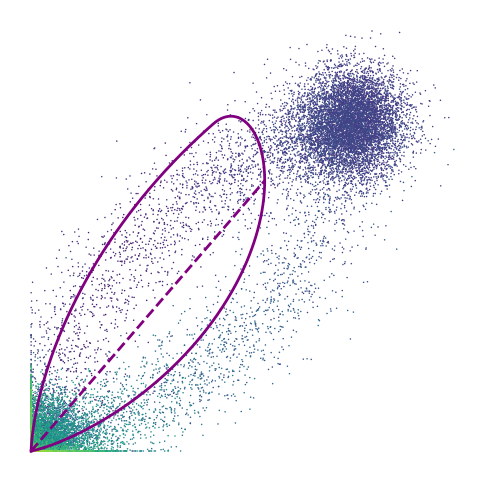

396


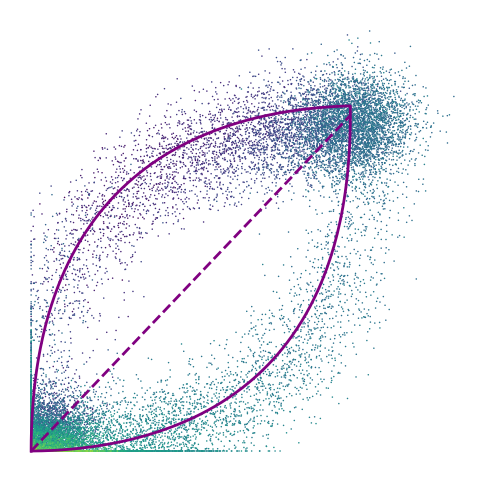

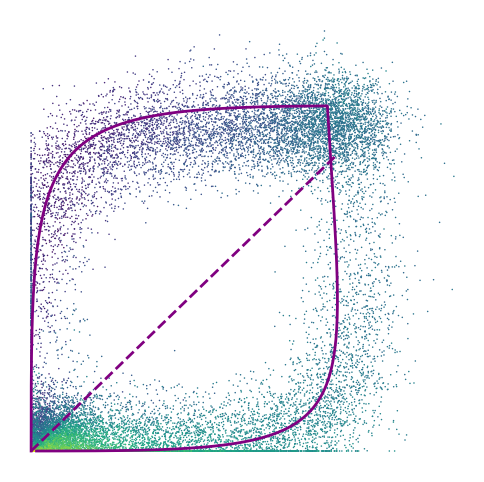

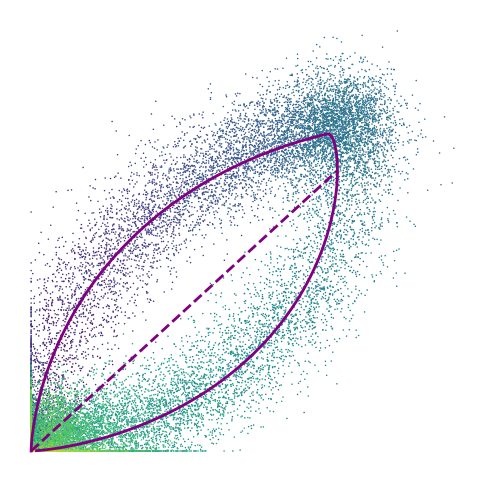

474


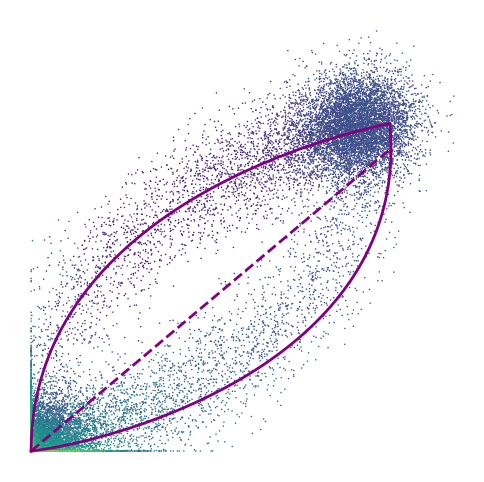

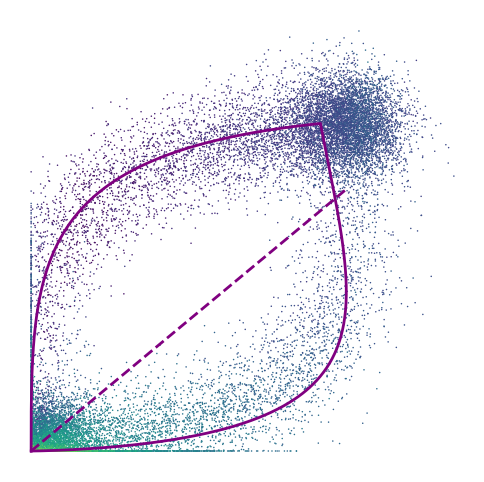

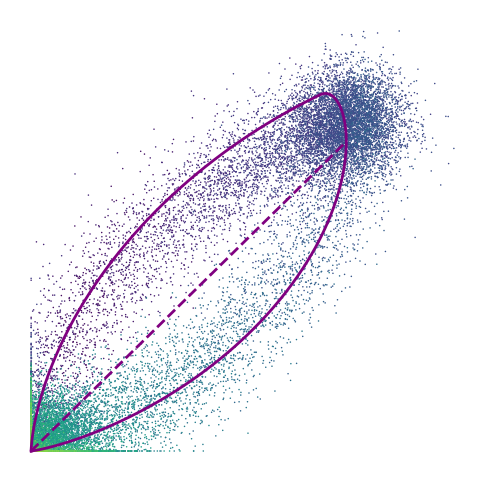

621


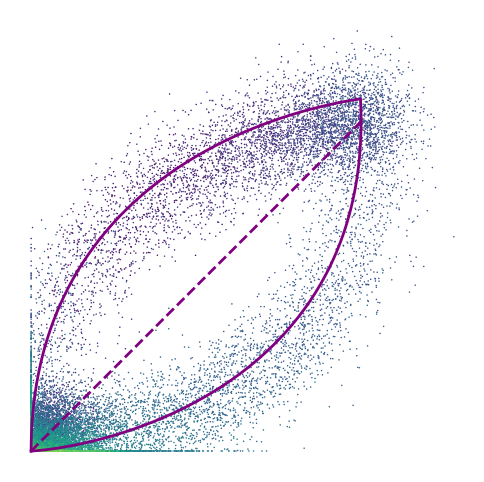

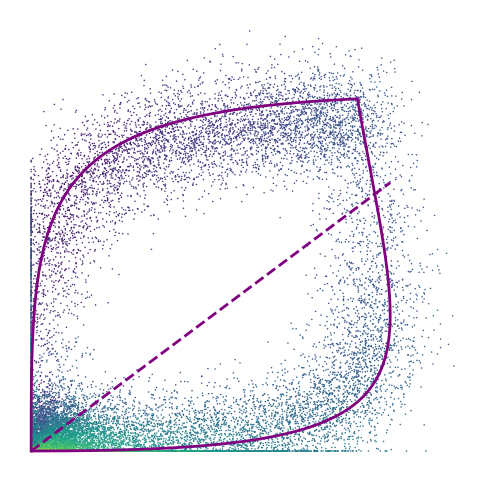

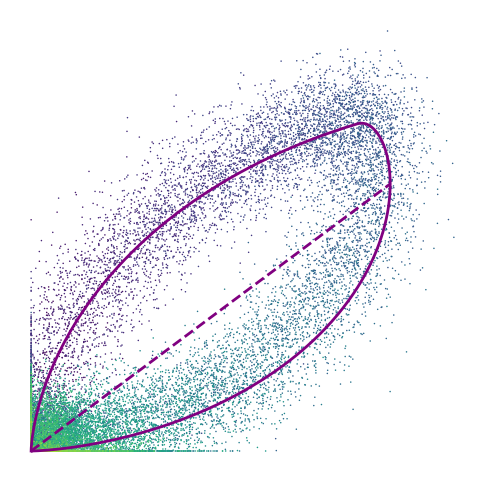

629


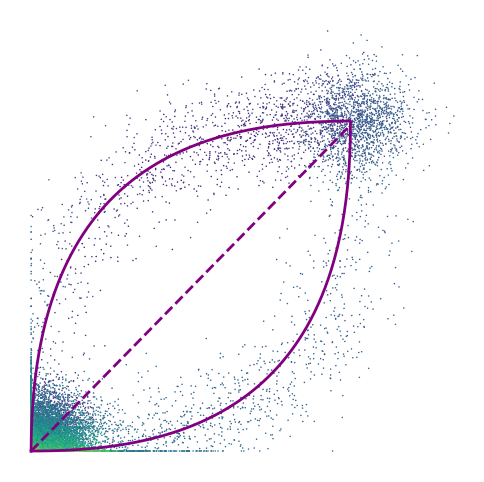

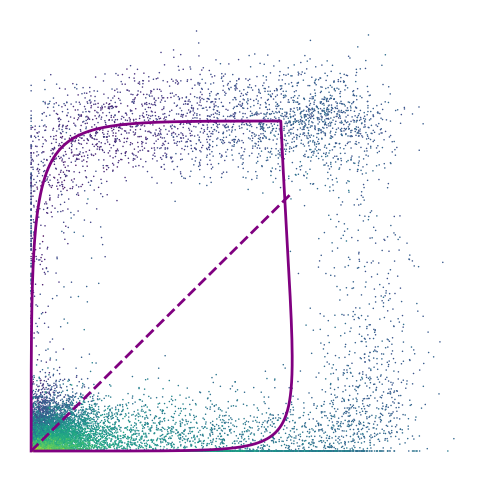

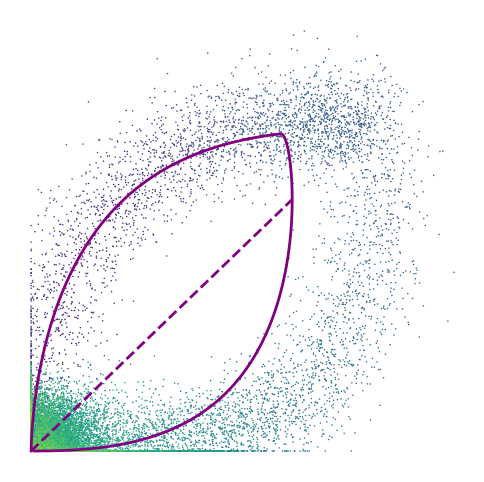

630


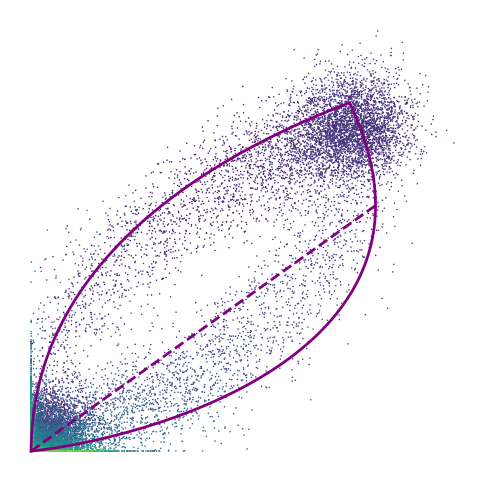

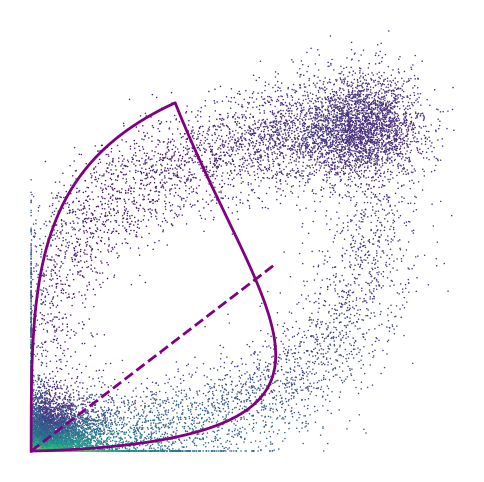

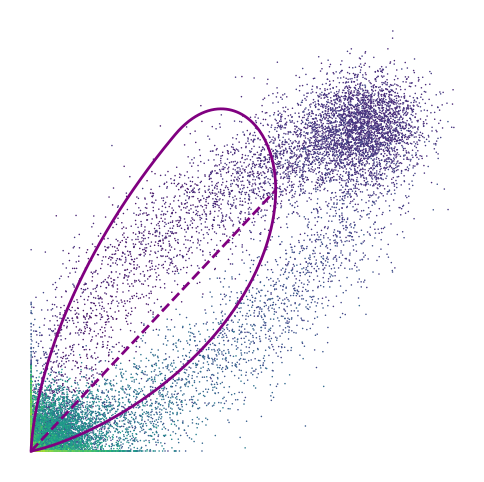

638


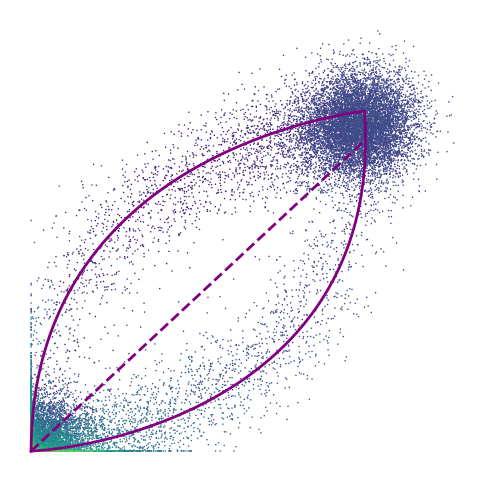

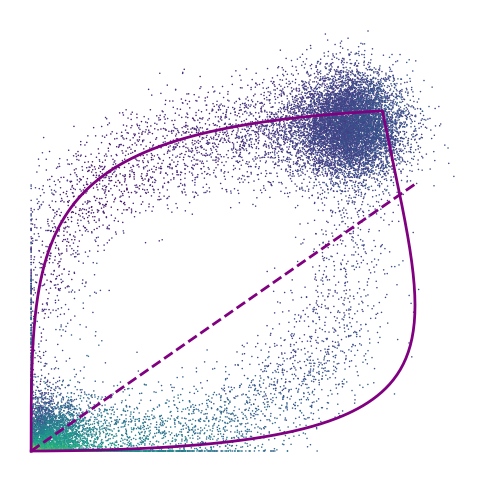

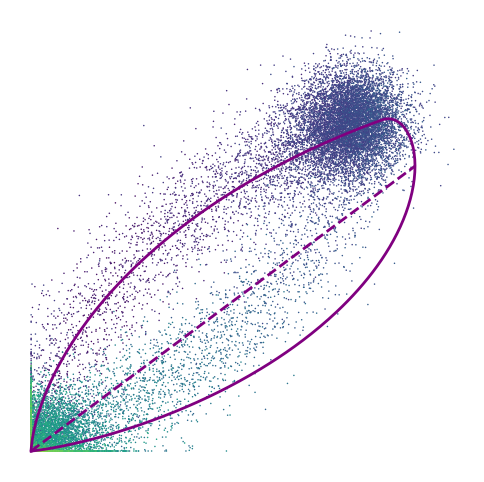

641


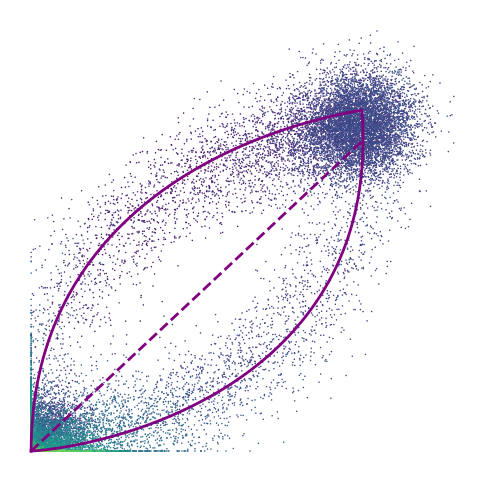

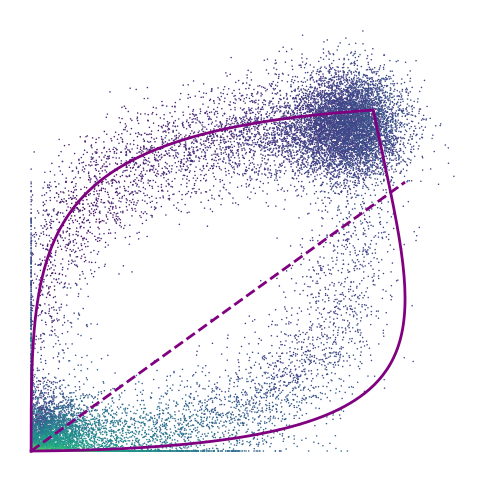

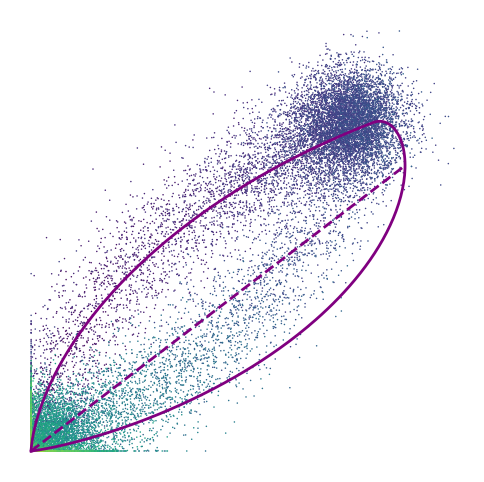

693


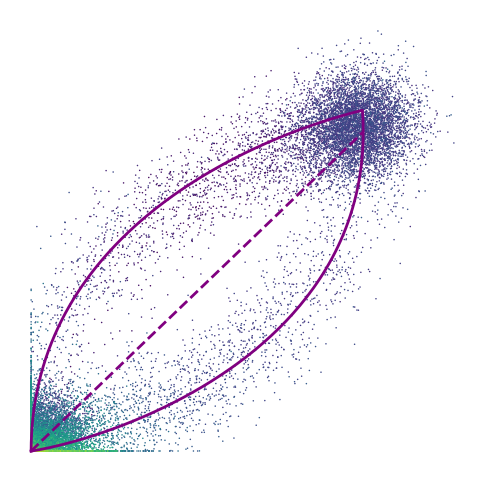

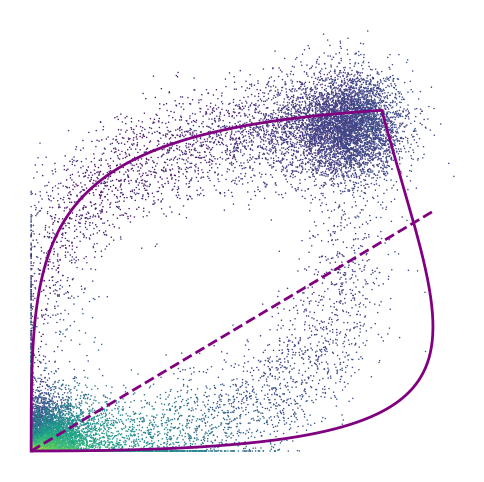

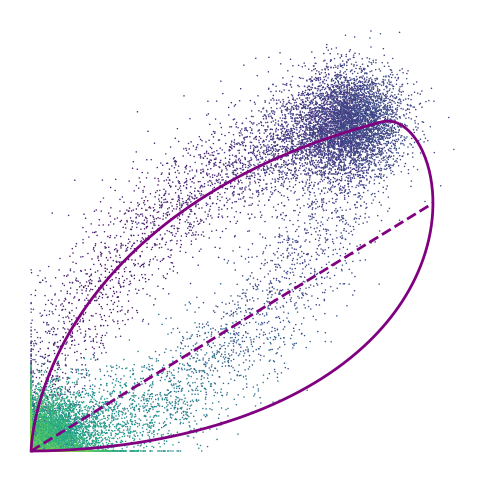

706


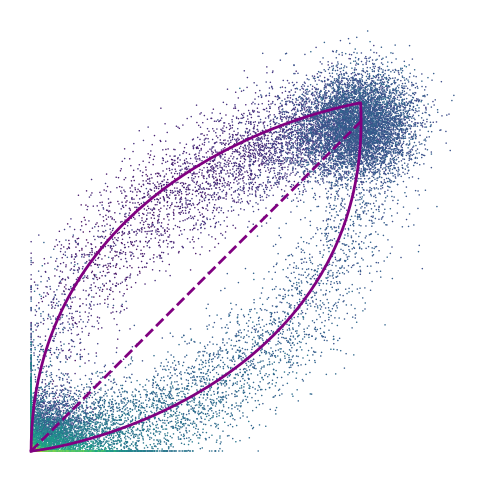

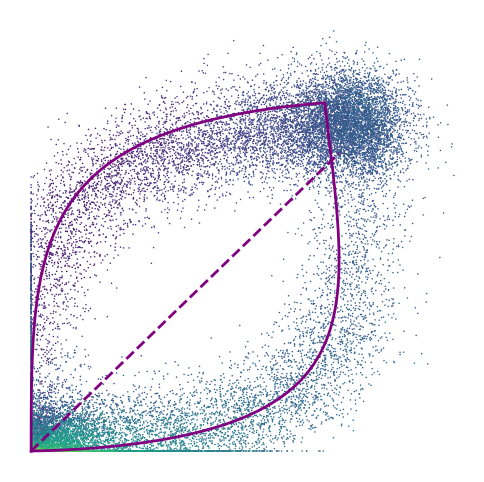

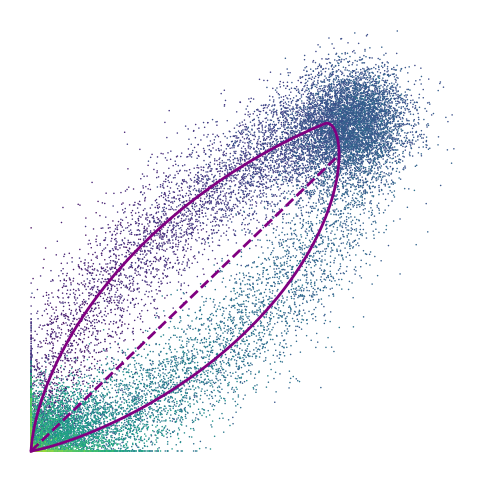

714


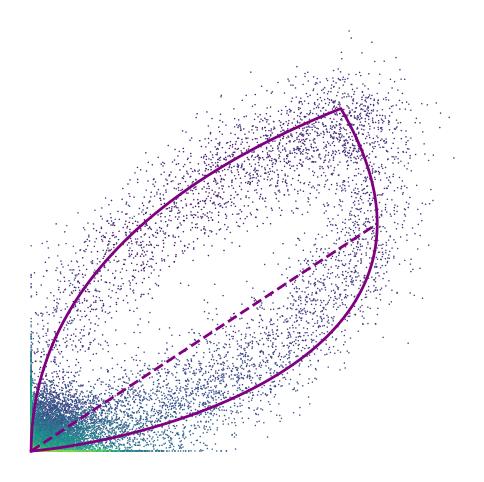

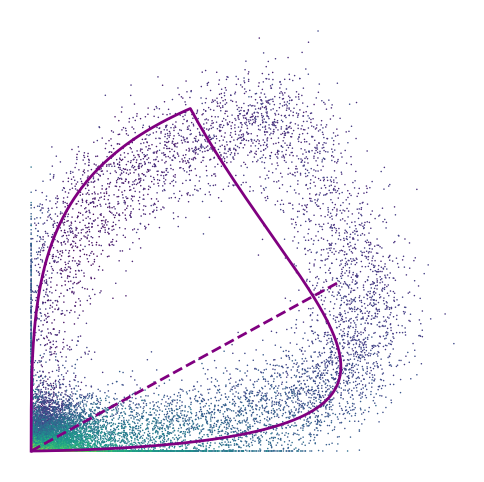

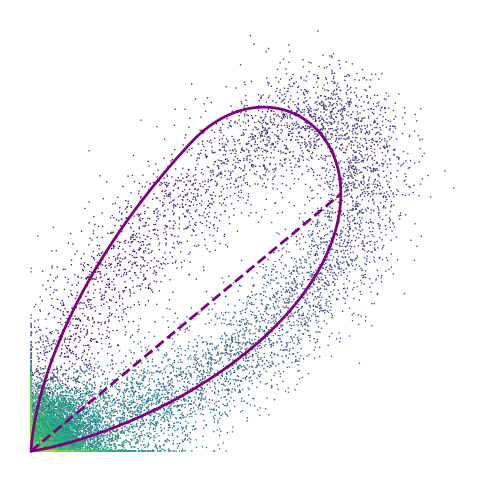

775


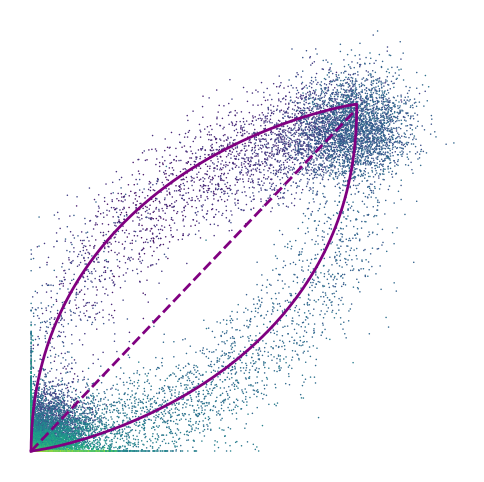

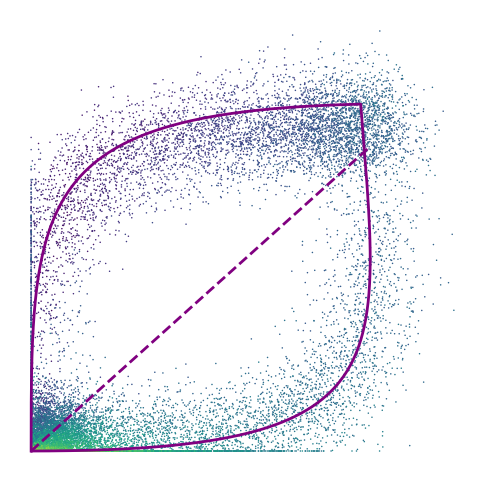

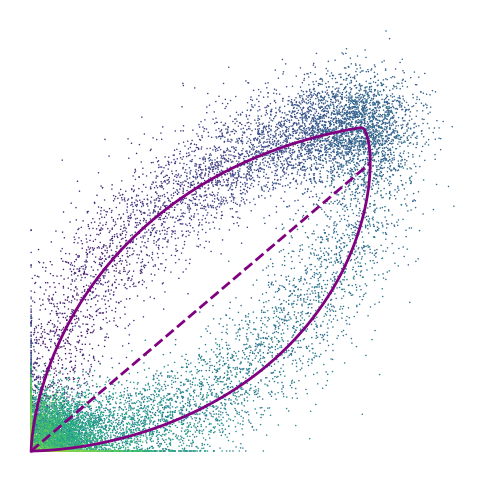

783


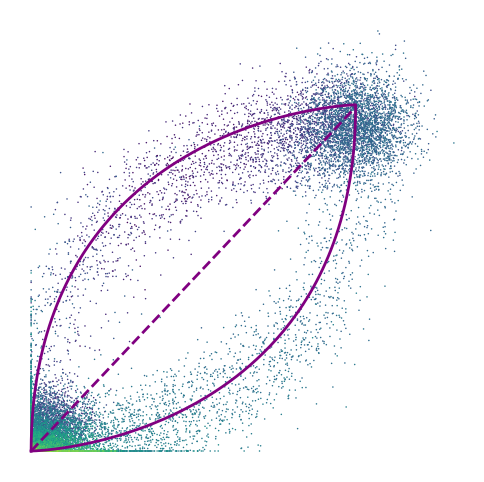

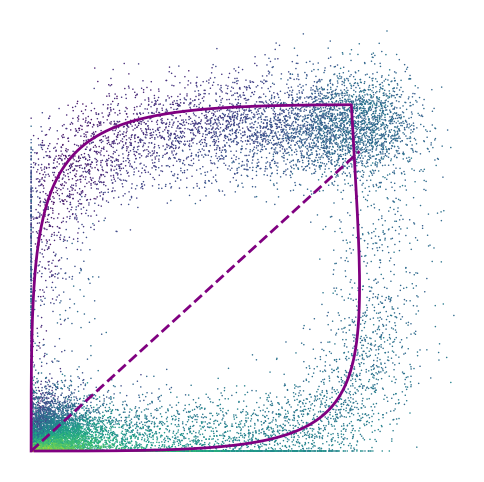

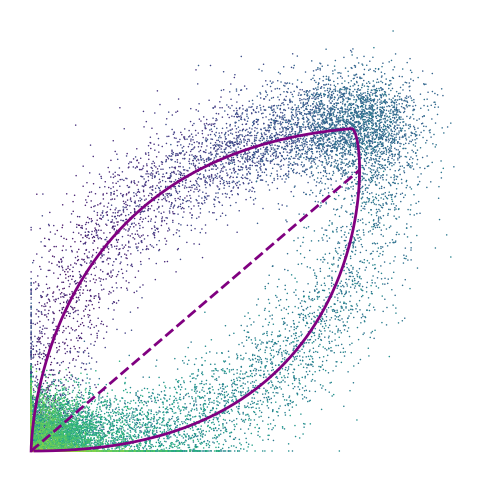

803


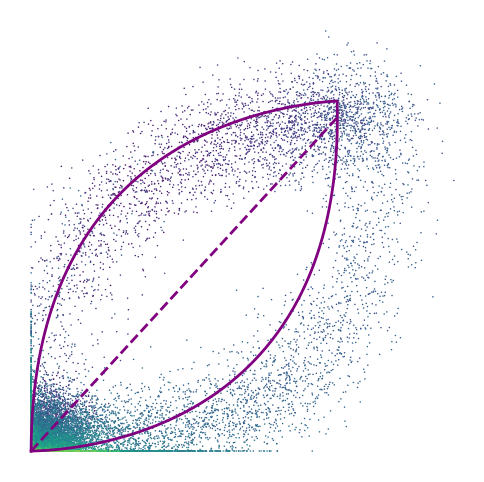

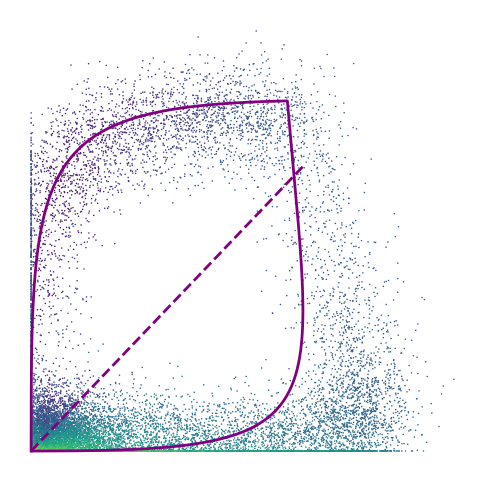

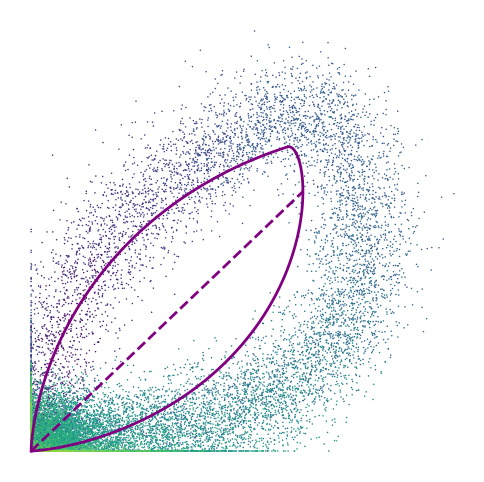

811


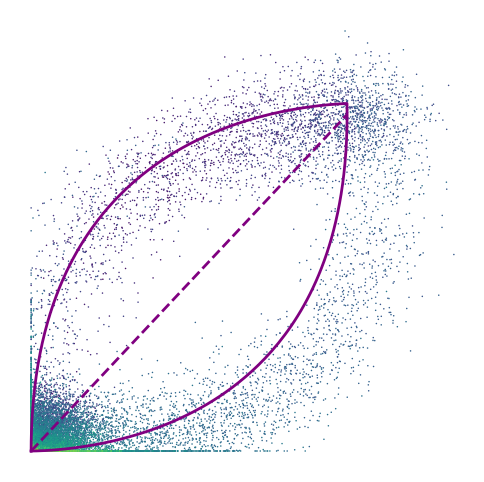

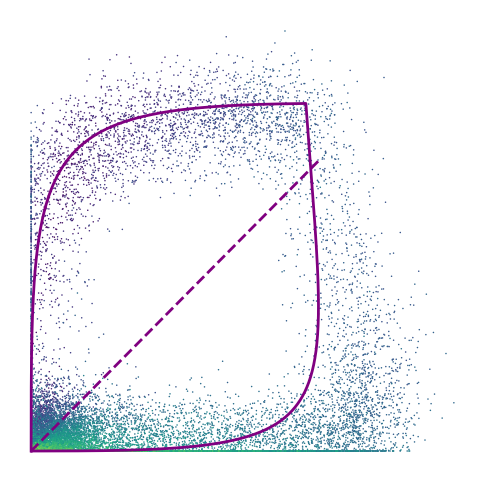

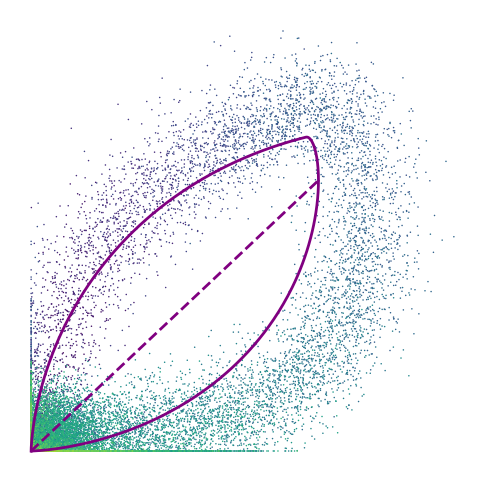

815


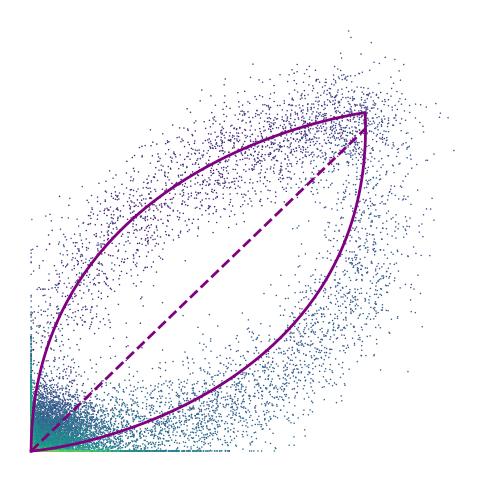

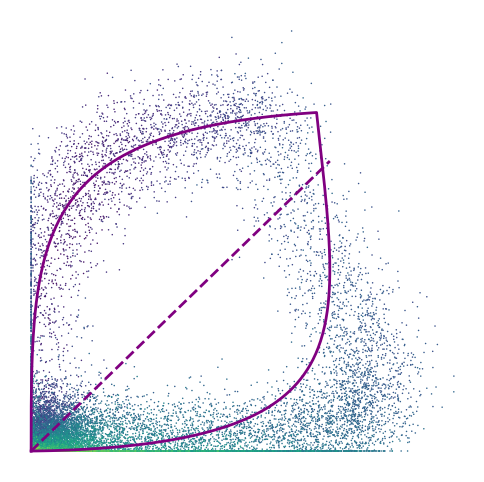

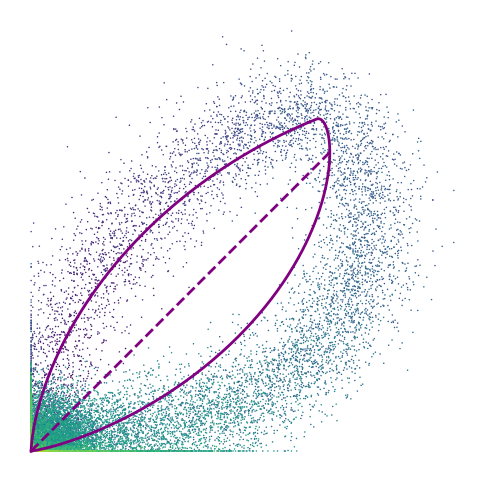

830


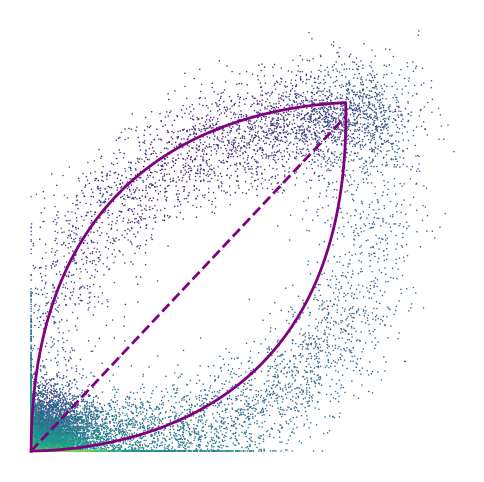

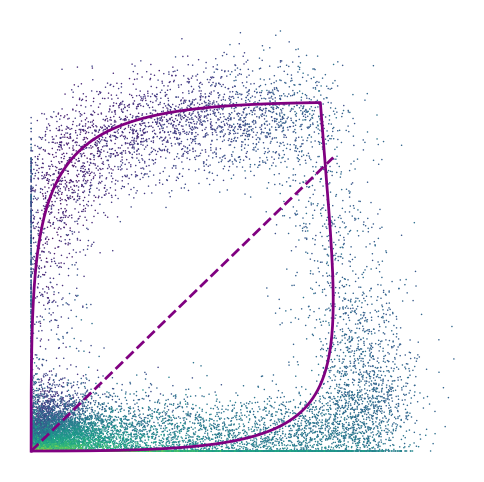

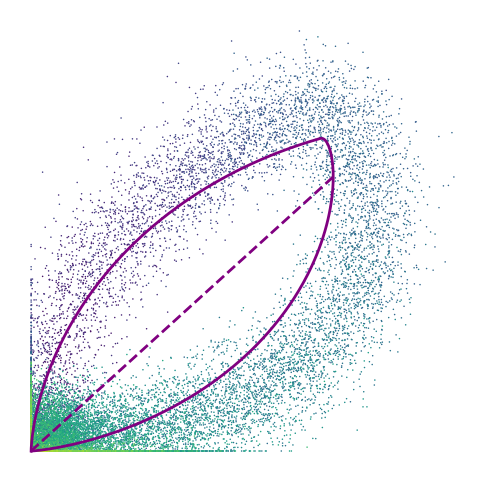

856


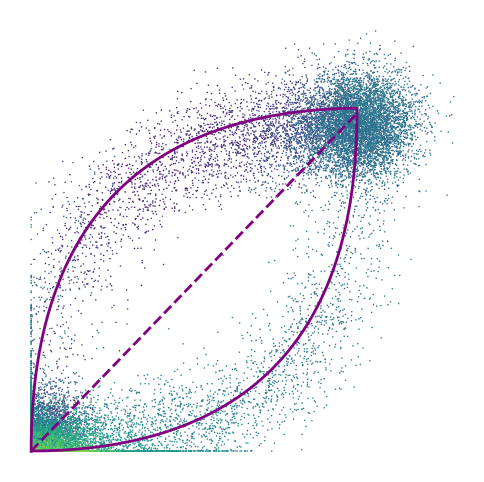

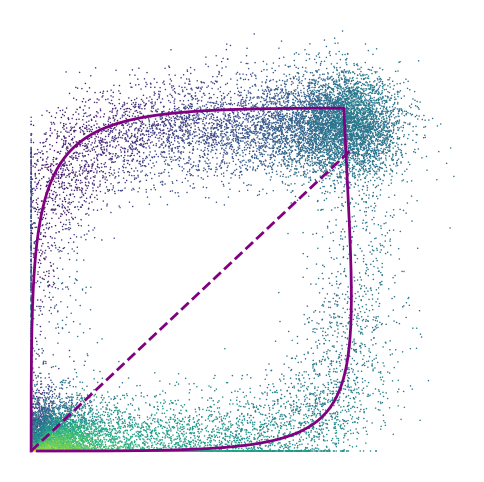

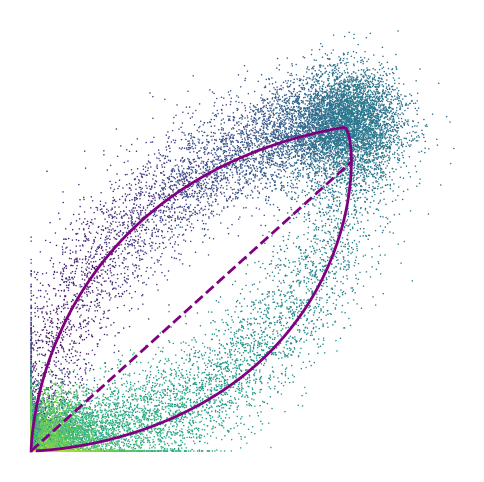

901


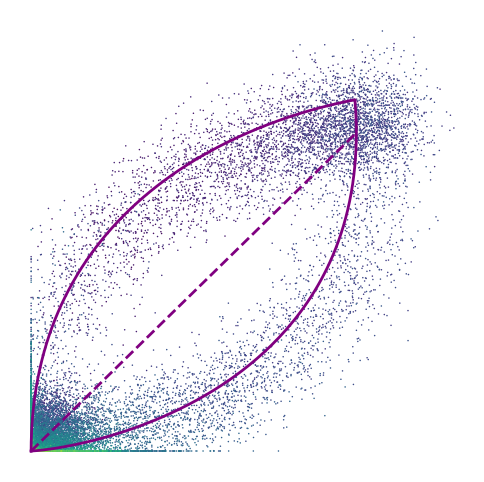

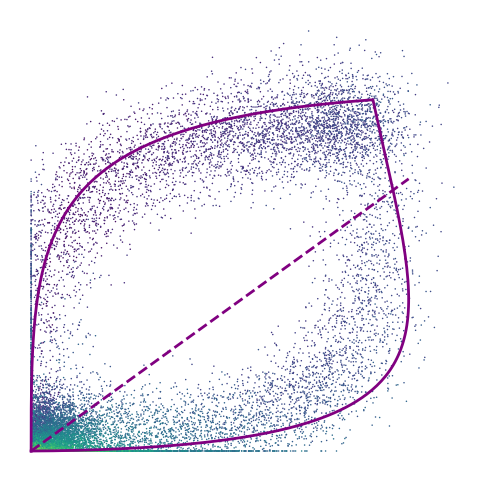

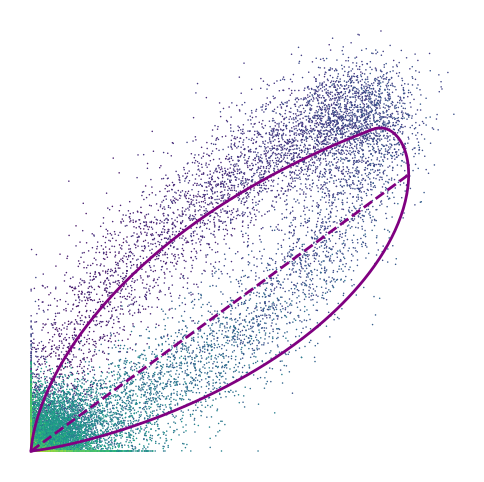

910


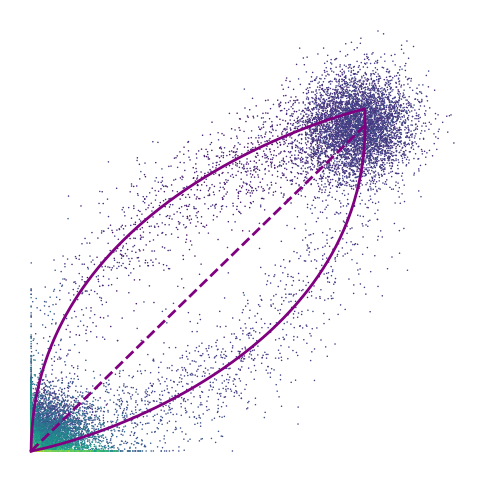

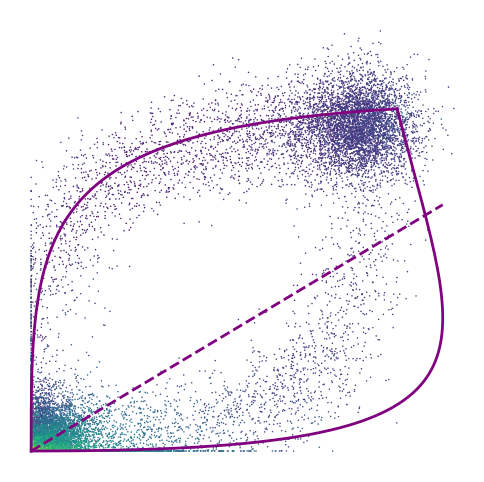

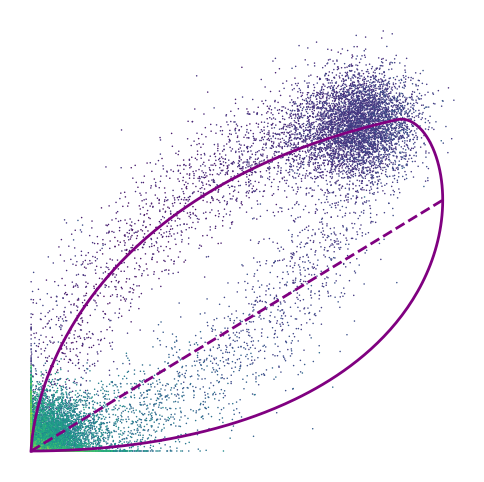

933


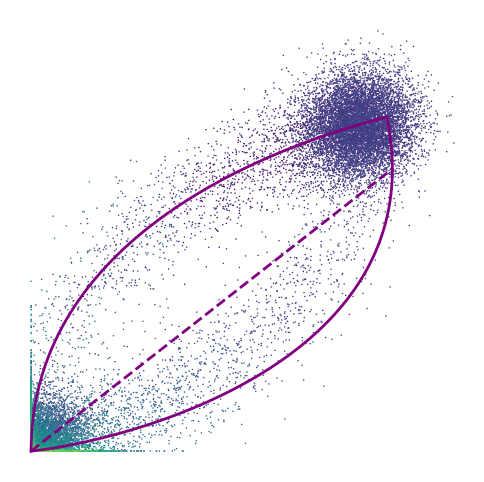

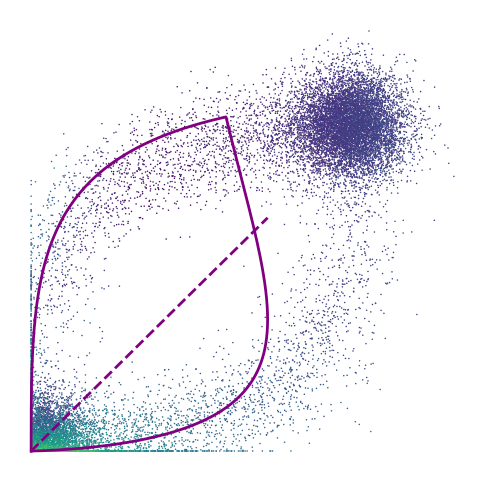

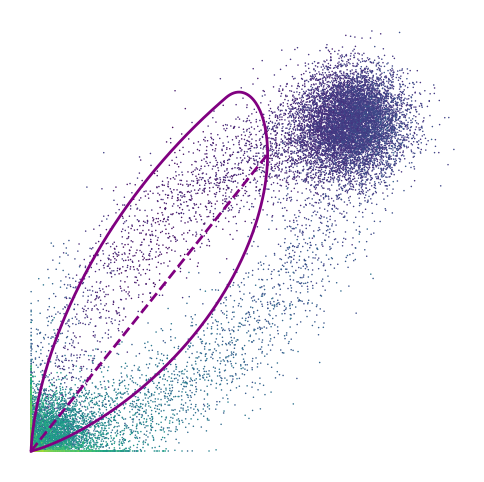

942


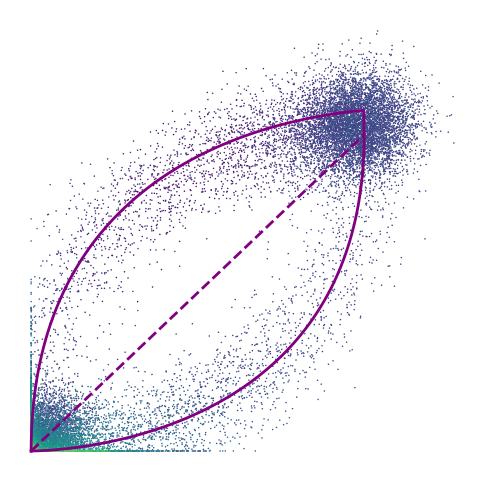

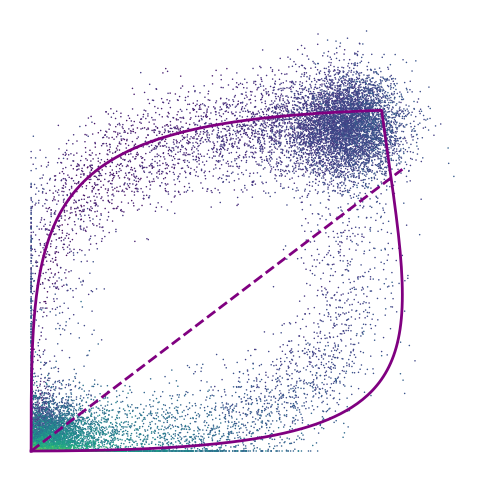

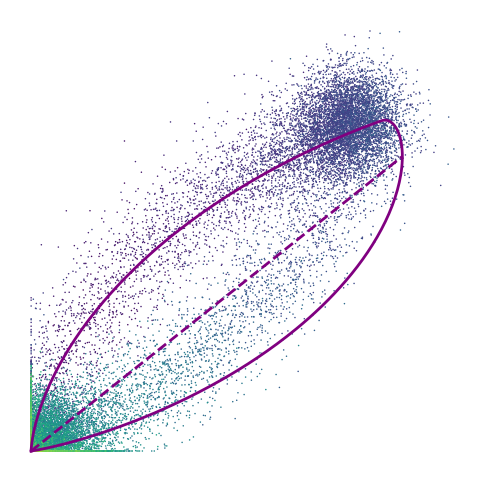

959


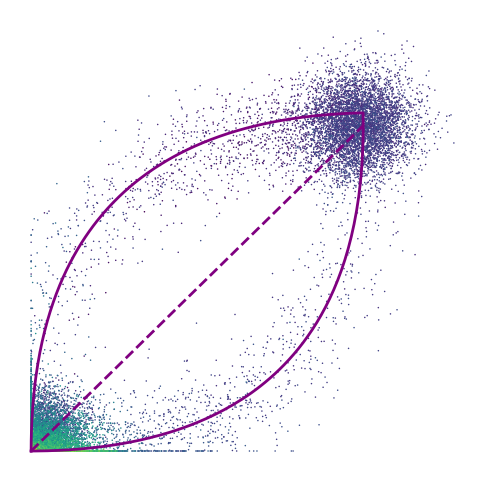

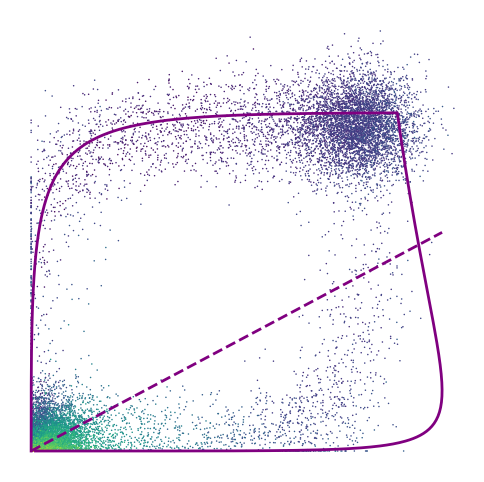

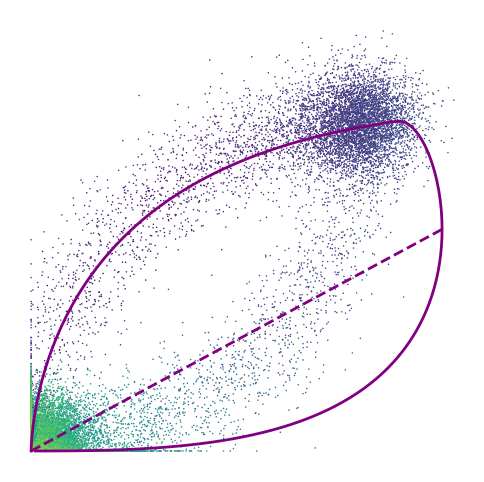

In [60]:
## Save phase portraits as .png (without axis
for gene in ad_subset.var_names:
    print(gene)
    # S_NUC vs U_NUC
    with mplscience.style_context():
        fig, ax = plt.subplots(figsize=(6, 6))

        ax = scv.pl.scatter(
            adata,
            x=adata[:, gene].layers["spliced_nucleus"],
            y=adata[:, gene].layers["unspliced_nucleus"],
            color=adata[:, gene].layers["fit_t"],
            ax=ax,
            show=False,
            colorbar=False,
        )
        ax.axis("off")

        scv.pl.plot_nuc_cyt_dynamics(ad_subset, gene, "purple", ax, "Ms_nuc", "Mu_nuc")
        plt.box(False)

        plt.show()
        if SAVE_FIGURES:
            path = FIG_DIR / "data_simulation" / "phase_portraits_bad_fit"
            path.mkdir(parents=True, exist_ok=True)
            fig.savefig(path / f"s_nuc_u_nuc_{gene}.png", format="png", transparent=True, bbox_inches="tight", dpi=500)

    # S_CYT vs U_NUC
    with mplscience.style_context():
        fig, ax = plt.subplots(figsize=(6, 6))

        ax = scv.pl.scatter(
            adata,
            x=adata[:, gene].layers["spliced_cytosol"],
            y=adata[:, gene].layers["unspliced_nucleus"],
            color=adata[:, gene].layers["fit_t"],
            ax=ax,
            show=False,
            colorbar=False,
        )
        ax.axis("off")
        scv.pl.plot_nuc_cyt_dynamics(ad_subset, gene, "purple", ax, "Ms_cyt", "Mu_nuc")
        plt.box(False)

        plt.show()
        if SAVE_FIGURES:
            path = FIG_DIR / "data_simulation" / "phase_portraits_bad_fit"
            path.mkdir(parents=True, exist_ok=True)
            fig.savefig(path / f"s_cyt_u_nuc_{gene}.png", format="png", transparent=True, bbox_inches="tight", dpi=500)

    # S_CYT vs S_NUC
    with mplscience.style_context():
        fig, ax = plt.subplots(figsize=(6, 6))

        ax = scv.pl.scatter(
            adata,
            x=adata[:, gene].layers["spliced_cytosol"],
            y=adata[:, gene].layers["spliced_nucleus"],
            color=adata[:, gene].layers["fit_t"],
            ax=ax,
            show=False,
            colorbar=False,
        )
        ax.axis("off")
        scv.pl.plot_nuc_cyt_dynamics(ad_subset, gene, "purple", ax, "Ms_cyt", "Ms_nuc")
        plt.box(False)

        plt.show()
        if SAVE_FIGURES:
            path = FIG_DIR / "data_simulation" / "phase_portraits_bad_fit"
            path.mkdir(parents=True, exist_ok=True)
            fig.savefig(path / f"s_cyt_s_nuc_{gene}.png", format="png", transparent=True, bbox_inches="tight", dpi=500)

### As svg with axis

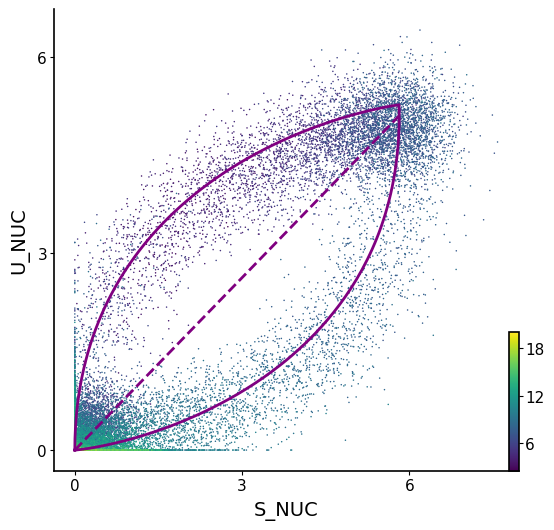

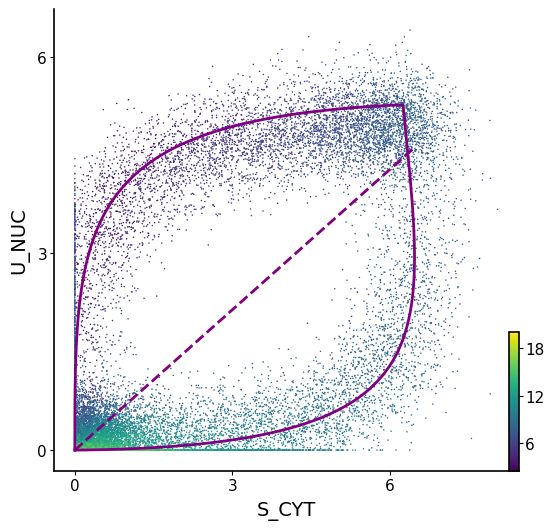

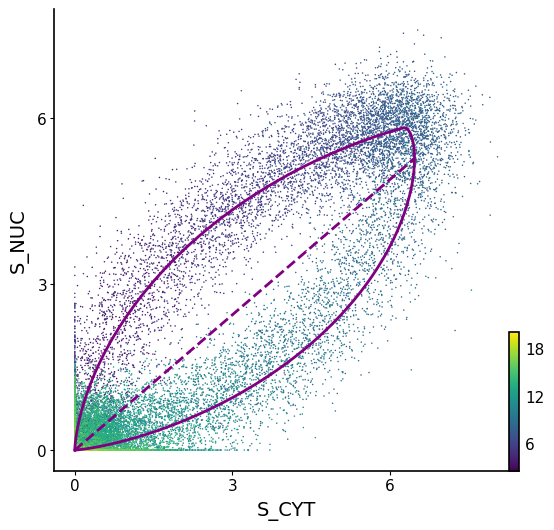

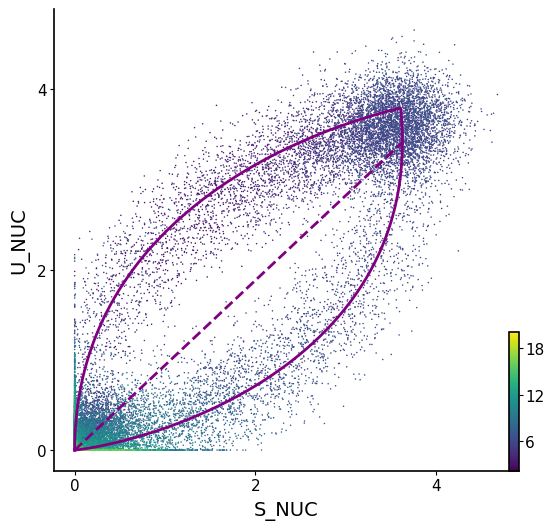

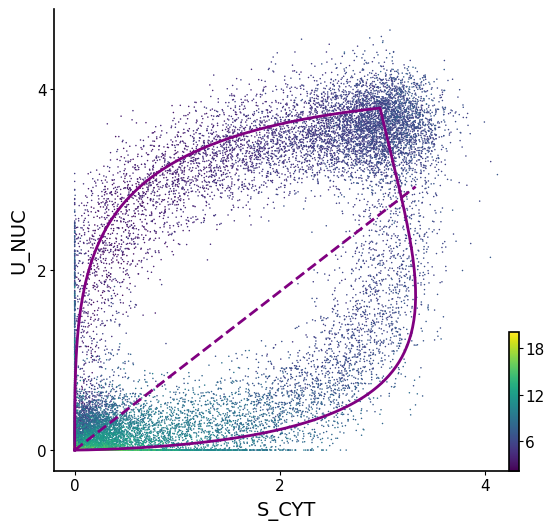

...

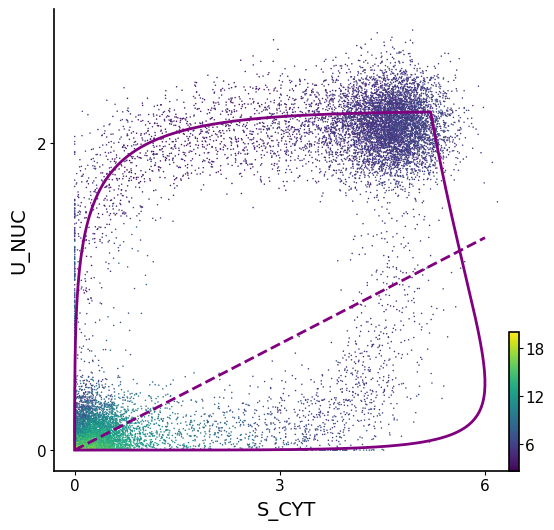

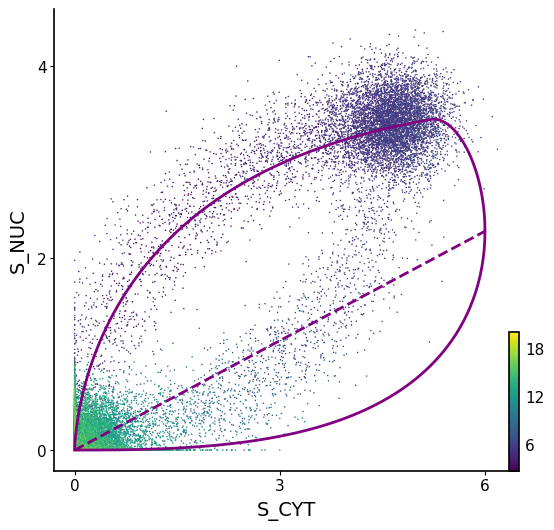

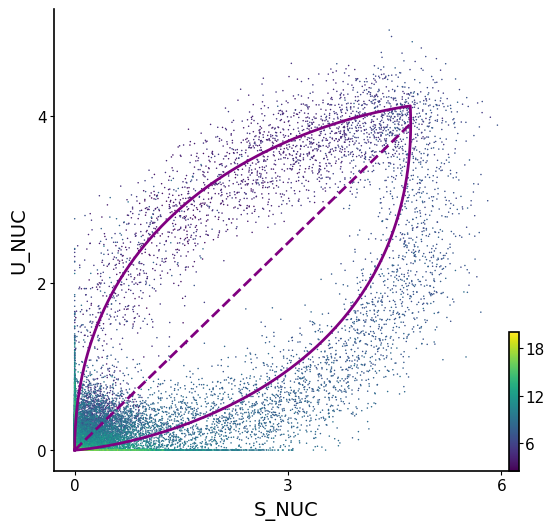

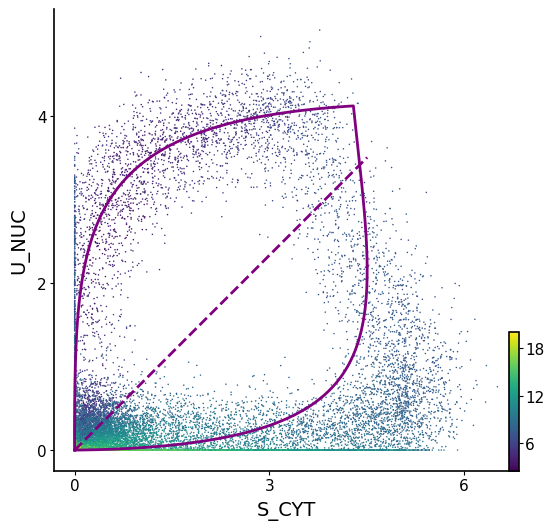

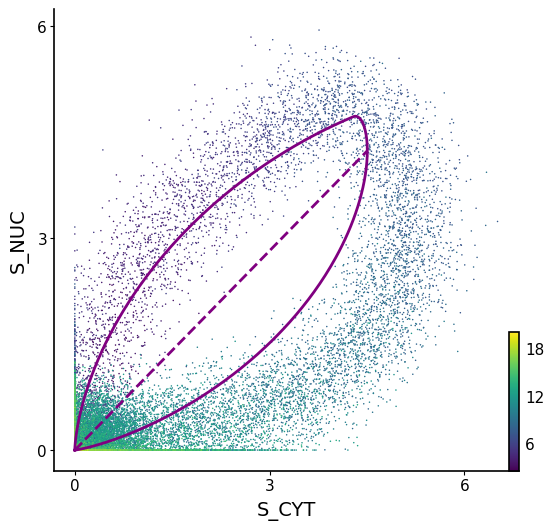

In [21]:
for gene in ad_subset.var_names[:5]:
    # S_NUC vs U_NUC
    with mplscience.style_context():
        fig, ax = plt.subplots(figsize=(6, 6))

        ax = scv.pl.scatter(
            adata,
            x=adata[:, gene].layers["spliced_nucleus"],
            y=adata[:, gene].layers["unspliced_nucleus"],
            color=adata[:, gene].layers["fit_t"],
            ax=ax,
            show=False,
        )
        ax.set_xlabel("S_NUC")
        ax.set_ylabel("U_NUC")
        scv.pl.plot_nuc_cyt_dynamics(ad_subset, gene, "purple", ax, "Ms_nuc", "Mu_nuc")
        plt.show()
        if SAVE_FIGURES:
            path = FIG_DIR / "data_simulation" / "phase_portraits_bad_fit"
            path.mkdir(parents=True, exist_ok=True)
            fig.savefig(path / f"s_nuc_u_nuc_{gene}.svg", format="svg", transparent=True, bbox_inches="tight")

    # S_CYT vs U_NUC
    with mplscience.style_context():
        fig, ax = plt.subplots(figsize=(6, 6))

        ax = scv.pl.scatter(
            adata,
            x=adata[:, gene].layers["spliced_cytosol"],
            y=adata[:, gene].layers["unspliced_nucleus"],
            color=adata[:, gene].layers["fit_t"],
            ax=ax,
            show=False,
        )
        ax.set_xlabel("S_CYT")
        ax.set_ylabel("U_NUC")
        scv.pl.plot_nuc_cyt_dynamics(ad_subset, gene, "purple", ax, "Ms_cyt", "Mu_nuc")
        plt.show()
        if SAVE_FIGURES:
            path = FIG_DIR / "data_simulation" / "phase_portraits_bad_fit"
            path.mkdir(parents=True, exist_ok=True)
            fig.savefig(path / f"s_cyt_u_nuc_{gene}.svg", format="svg", transparent=True, bbox_inches="tight")

    # S_CYT vs S_NUC
    with mplscience.style_context():
        fig, ax = plt.subplots(figsize=(6, 6))

        ax = scv.pl.scatter(
            adata,
            x=adata[:, gene].layers["spliced_cytosol"],
            y=adata[:, gene].layers["spliced_nucleus"],
            color=adata[:, gene].layers["fit_t"],
            ax=ax,
            show=False,
        )
        plt.tick_params(left=False, right=False, labelleft=False, labelbottom=False, bottom=False)
        ax.set_xlabel("S_CYT")
        ax.set_ylabel("S_NUC")
        scv.pl.plot_nuc_cyt_dynamics(ad_subset, gene, "purple", ax, "Ms_cyt", "Ms_nuc")
        plt.show()
        if SAVE_FIGURES:
            path = FIG_DIR / "data_simulation" / "phase_portraits_bad_fit"
            path.mkdir(parents=True, exist_ok=True)
            fig.savefig(path / f"s_cyt_s_nuc_{gene}.svg", format="svg", transparent=True, bbox_inches="tight")

### 2. MSE Comparison

In [ ]:
# first we will get model's fit to also get MSE loss
fits_s_cyt, fits_s_nuc, fits_u_nuc = vae.get_expression_fit(n_samples=20, return_numpy=True)

mse_s_cyt = np.mean((fits_s_cyt - adata.layers["spliced_cytosol"]) ** 2, axis=0)
mse_s_nuc = np.mean((fits_s_nuc - adata.layers["spliced_nucleus"]) ** 2, axis=0)
mse_u_nuc = np.mean((fits_u_nuc - adata.layers["unspliced_nucleus"]) ** 2, axis=0)

outlier_mse_s_cyt = mse_s_cyt[ad_subset.var_names.astype(int)]
outlier_mse_s_nuc = mse_s_nuc[ad_subset.var_names.astype(int)]
outlier_mse_u_nuc = mse_u_nuc[ad_subset.var_names.astype(int)]

mask = np.ones(mse_u_nuc.size, dtype=bool)
mask[ad_subset.var_names.astype(int)] = False

rest_mse_s_cyt = mse_s_cyt[mask]
rest_mse_s_nuc = mse_s_nuc[mask]
rest_mse_u_nuc = mse_u_nuc[mask]

mse_df = pd.DataFrame()
mse_df["MSE"] = np.concatenate([outlier_mse_s_cyt, outlier_mse_s_nuc, outlier_mse_u_nuc]).ravel()
mse_df["Feature"] = (
    ["Spliced cytosol"] * len(outlier_mse_s_cyt)
    + ["Spliced nucleus"] * len(outlier_mse_s_nuc)
    + ["Unspliced nucleus"] * len(outlier_mse_u_nuc)
)
mse_df["Genes"] = "Outlier genes"
mse_df_2 = pd.DataFrame()
mse_df_2["MSE"] = np.concatenate([rest_mse_s_cyt, rest_mse_s_nuc, rest_mse_u_nuc]).ravel()
mse_df_2["Feature"] = (
    ["Spliced cytosol"] * len(rest_mse_s_cyt)
    + ["Spliced nucleus"] * len(rest_mse_s_nuc)
    + ["Unspliced nucleus"] * len(rest_mse_u_nuc)
)
mse_df_2["Genes"] = "Other genes"

mse_df = pd.concat([mse_df, mse_df_2])
mse_df["log10_MSE"] = np.log10(mse_df.MSE)

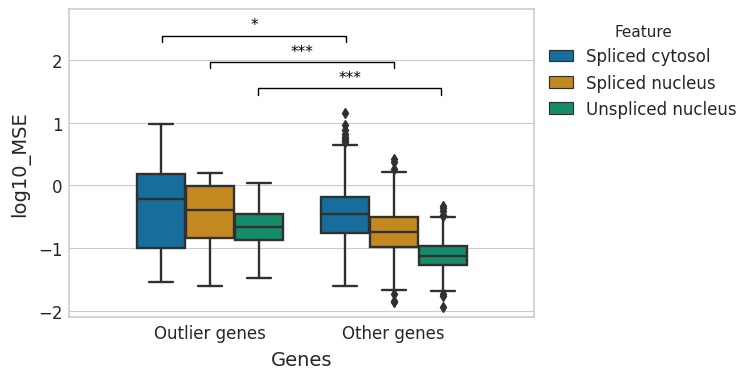

In [190]:
# log10 MSE
with mplscience.style_context():
    sns.set_style(style="whitegrid")
    fig, ax = plt.subplots(figsize=(6, 4))
    sns.boxplot(
        data=mse_df,  # JUST FOR PLOT: THere are many
        x="Genes",
        y="log10_MSE",
        hue="Feature",
        palette=sns.color_palette("colorblind").as_hex()[:3],
    )
    y_min, y_max = ax.get_ylim()
    ax.set_ylim([y_min, y_max + 1.5])

    # S_CYT
    ttest_res = ttest_ind(
        mse_df.loc[(mse_df.Feature == "Spliced cytosol") & (mse_df.Genes == "Outlier genes"), "MSE"],
        mse_df.loc[(mse_df.Feature == "Spliced cytosol") & (mse_df.Genes != "Outlier genes"), "MSE"],
        equal_var=False,
        alternative="greater",
    )
    significance = _get_significance(ttest_res.pvalue)
    _add_significance(
        ax=ax,
        left=-0.26,
        right=0.74,
        significance=significance,
        lw=1,
        bracket_level=0.85,
        c="k",
        level=0,
    )
    # S_NUC
    ttest_res = ttest_ind(
        mse_df.loc[(mse_df.Feature == "Spliced nucleus") & (mse_df.Genes == "Outlier genes"), "MSE"],
        mse_df.loc[(mse_df.Feature == "Spliced nucleus") & (mse_df.Genes != "Outlier genes"), "MSE"],
        equal_var=False,
        alternative="greater",
    )
    significance = _get_significance(ttest_res.pvalue)
    _add_significance(
        ax=ax,
        left=-0,
        right=1,
        significance=significance,
        lw=1,
        bracket_level=0.7,
        c="k",
        level=0,
    )
    # U_NUC
    ttest_res = ttest_ind(
        mse_df.loc[(mse_df.Feature == "Unspliced nucleus") & (mse_df.Genes == "Outlier genes"), "MSE"],
        mse_df.loc[(mse_df.Feature == "Unspliced nucleus") & (mse_df.Genes != "Outlier genes"), "MSE"],
        equal_var=False,
        alternative="greater",
    )
    significance = _get_significance(ttest_res.pvalue)
    _add_significance(
        ax=ax,
        left=0.26,
        right=1.26,
        significance=significance,
        lw=1,
        bracket_level=0.55,
        c="k",
        level=0,
    )

    sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
    plt.show()
    if SAVE_FIGURES:
        path = FIG_DIR / "data_simulation" / "mse_comparison"
        path.mkdir(parents=True, exist_ok=True)
        fig.savefig(path / "mse_outlier_rest_box.svg", format="svg", transparent=True, bbox_inches="tight")

## Zoom into genes where ratio is very close to standard diagonal

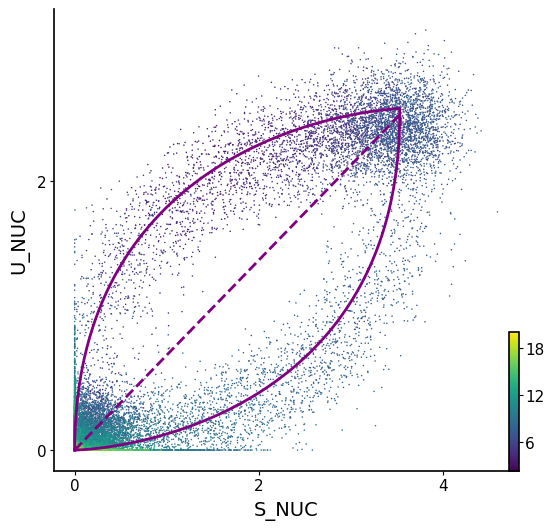

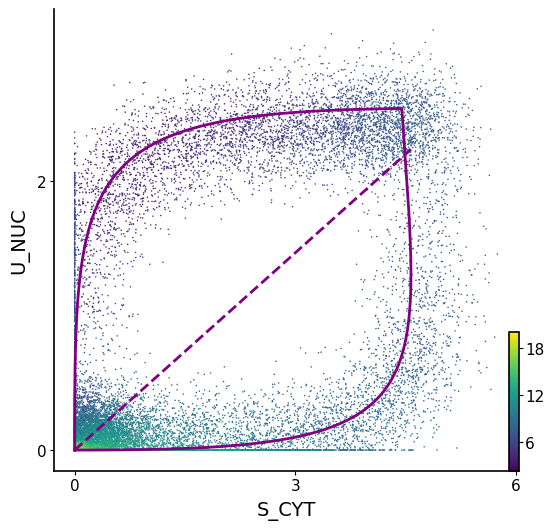

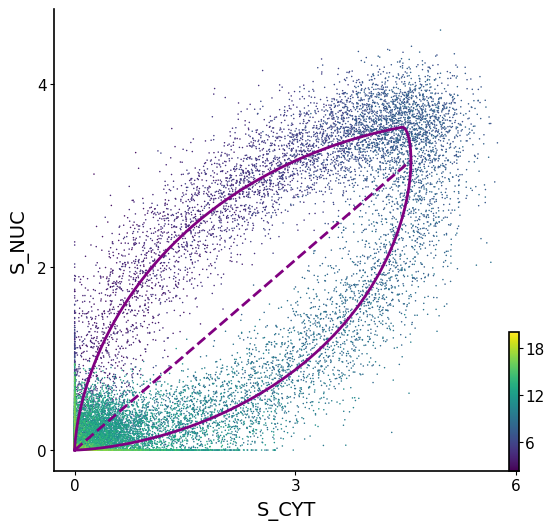

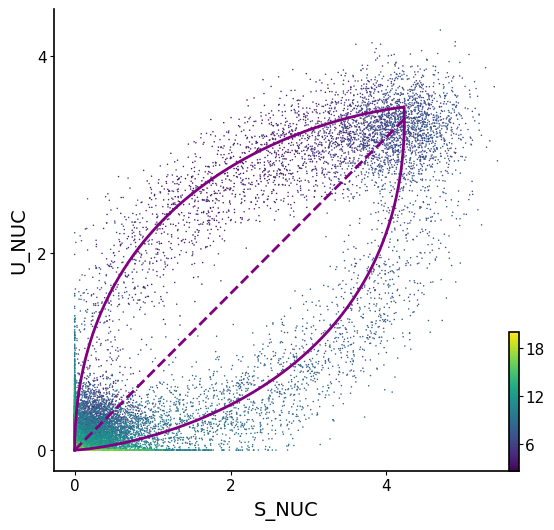

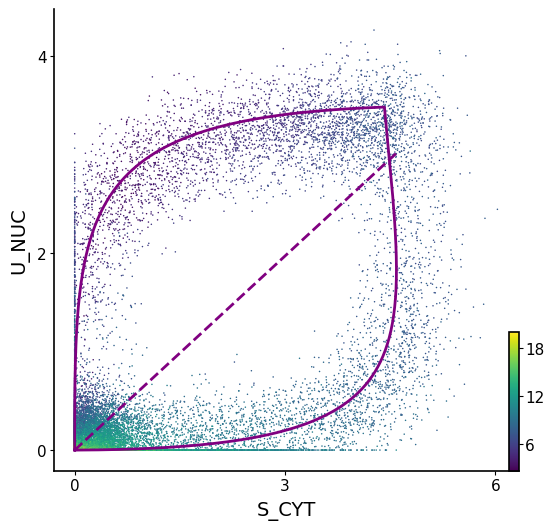

...

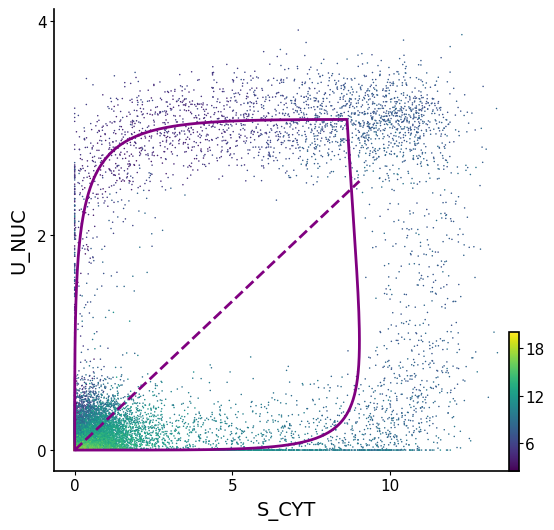

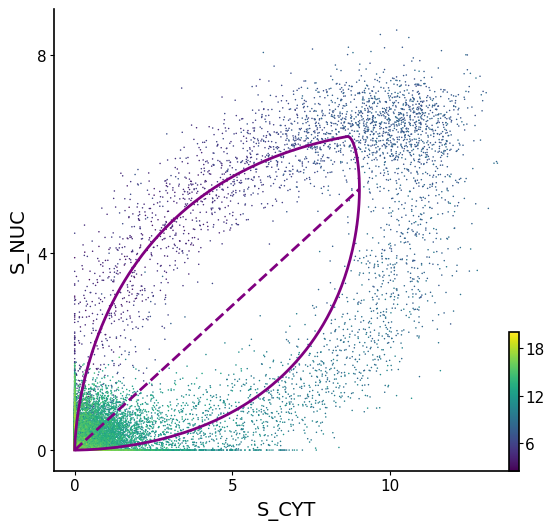

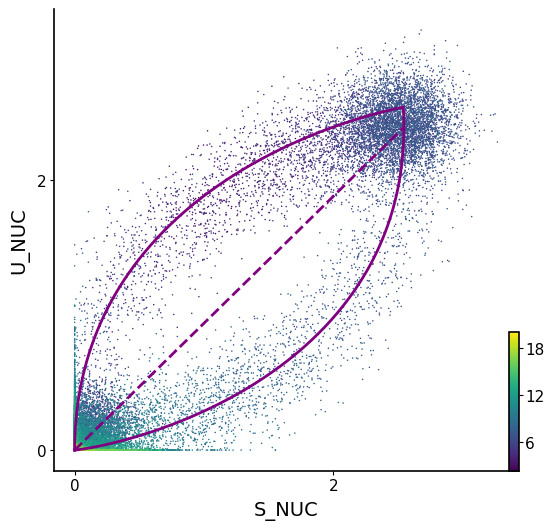

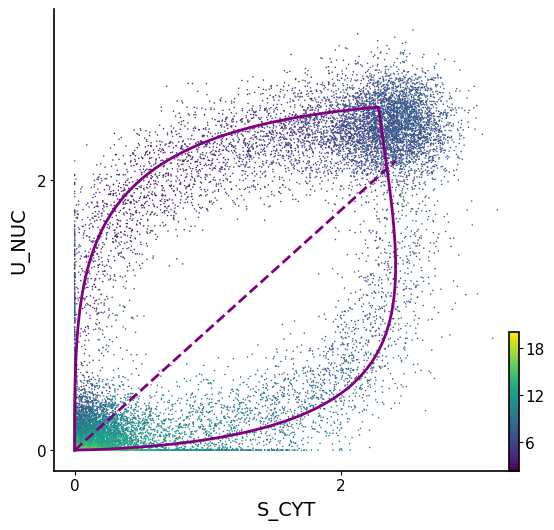

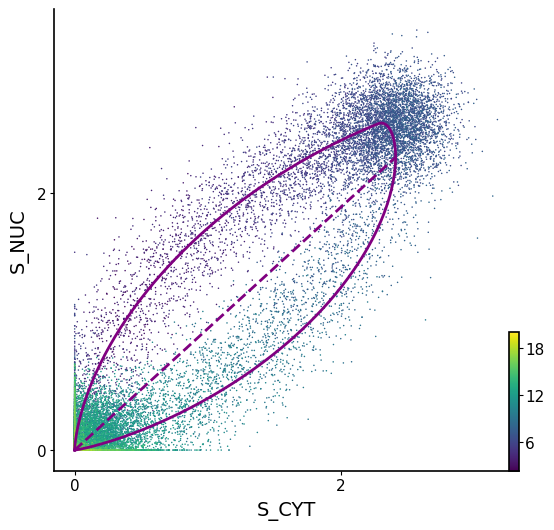

In [192]:
ad_subset = adata[
    :,
    (ratio_deviation_1 < np.percentile(ratio_deviation_1, 0.2))
    | (ratio_deviation_2 < np.percentile(ratio_deviation_2, 0.2))
    | (ratio_deviation_3 < np.percentile(ratio_deviation_3, 0.2))
    | (ratio_deviation_4 < np.percentile(ratio_deviation_4, 0.2))
    | (ratio_deviation_5 < np.percentile(ratio_deviation_5, 0.2)),
]

for gene in ad_subset.var_names:
    # S_NUC vs U_NUC
    with mplscience.style_context():
        fig, ax = plt.subplots(figsize=(6, 6))

        ax = scv.pl.scatter(
            adata,
            x=adata[:, gene].layers["spliced_nucleus"],
            y=adata[:, gene].layers["unspliced_nucleus"],
            color=adata[:, gene].layers["fit_t"],
            ax=ax,
            show=False,
        )
        ax.set_xlabel("S_NUC")
        ax.set_ylabel("U_NUC")
        scv.pl.plot_nuc_cyt_dynamics(ad_subset, gene, "purple", ax, "Ms_nuc", "Mu_nuc")
        plt.show()
        if SAVE_FIGURES:
            path = FIG_DIR / "data_simulation" / "phase_portraits_good_fit"
            path.mkdir(parents=True, exist_ok=True)
            fig.savefig(path / f"s_nuc_u_nuc_{gene}.svg", format="svg", transparent=True, bbox_inches="tight")

    # S_CYT vs U_NUC
    with mplscience.style_context():
        fig, ax = plt.subplots(figsize=(6, 6))

        ax = scv.pl.scatter(
            adata,
            x=adata[:, gene].layers["spliced_cytosol"],
            y=adata[:, gene].layers["unspliced_nucleus"],
            color=adata[:, gene].layers["fit_t"],
            ax=ax,
            show=False,
        )
        ax.set_xlabel("S_CYT")
        ax.set_ylabel("U_NUC")
        scv.pl.plot_nuc_cyt_dynamics(ad_subset, gene, "purple", ax, "Ms_cyt", "Mu_nuc")
        plt.show()
        if SAVE_FIGURES:
            path = FIG_DIR / "data_simulation" / "phase_portraits_good_fit"
            path.mkdir(parents=True, exist_ok=True)
            fig.savefig(path / f"s_cyt_u_nuc_{gene}.svg", format="svg", transparent=True, bbox_inches="tight")

    # S_CYT vs S_NUC
    with mplscience.style_context():
        fig, ax = plt.subplots(figsize=(6, 6))

        ax = scv.pl.scatter(
            adata,
            x=adata[:, gene].layers["spliced_cytosol"],
            y=adata[:, gene].layers["spliced_nucleus"],
            color=adata[:, gene].layers["fit_t"],
            ax=ax,
            show=False,
        )
        ax.set_xlabel("S_CYT")
        ax.set_ylabel("S_NUC")
        scv.pl.plot_nuc_cyt_dynamics(ad_subset, gene, "purple", ax, "Ms_cyt", "Ms_nuc")
        plt.show()
        if SAVE_FIGURES:
            path = FIG_DIR / "data_simulation" / "phase_portraits_good_fit"
            path.mkdir(parents=True, exist_ok=True)
            fig.savefig(path / f"s_cyt_s_nuc_{gene}.svg", format="svg", transparent=True, bbox_inches="tight")

## as png

230


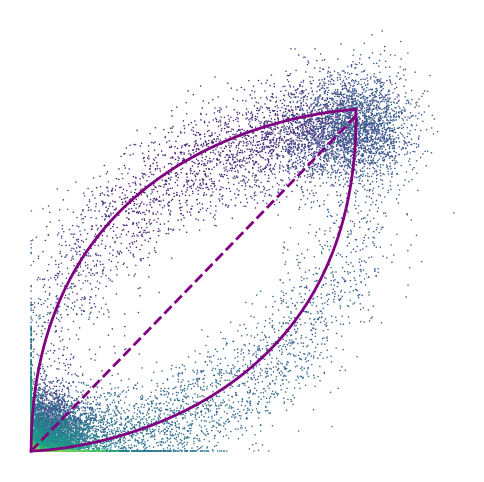

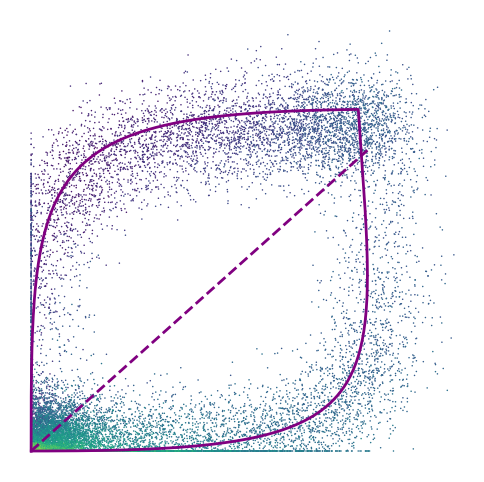

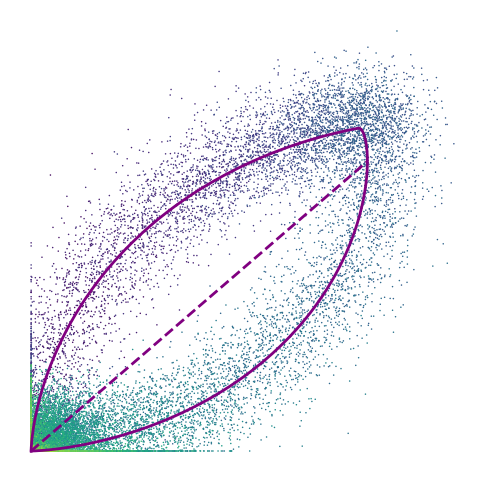

237


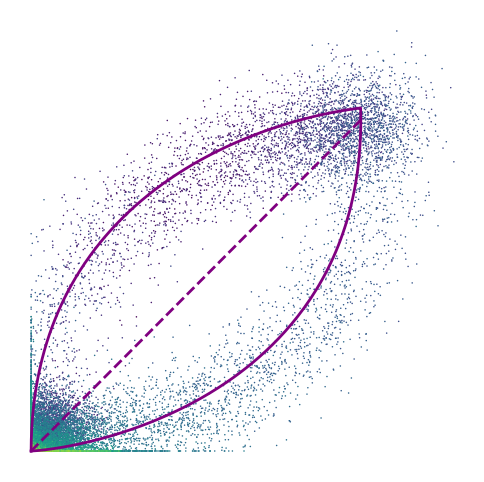

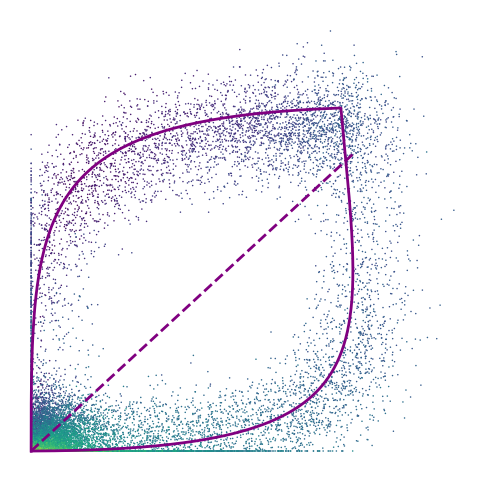

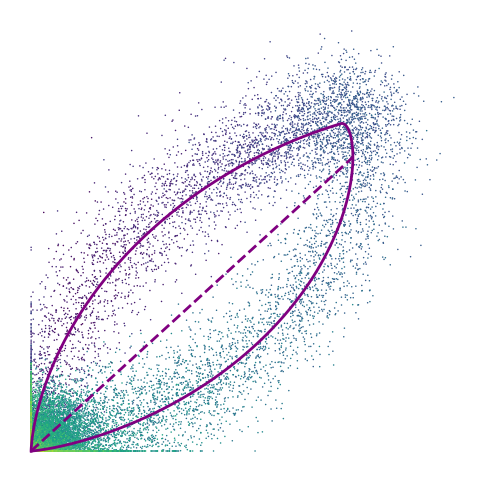

238


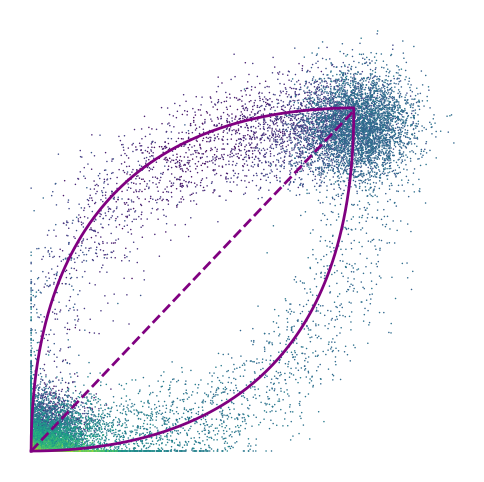

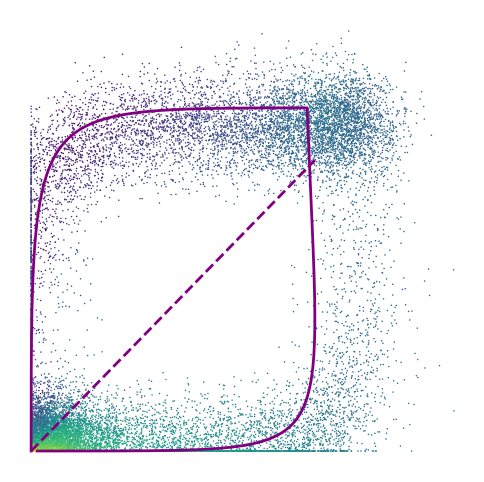

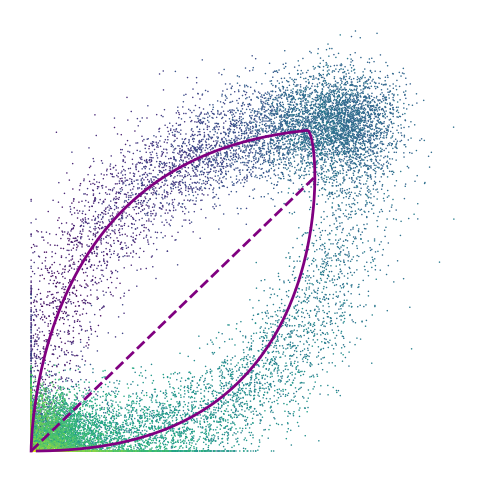

478


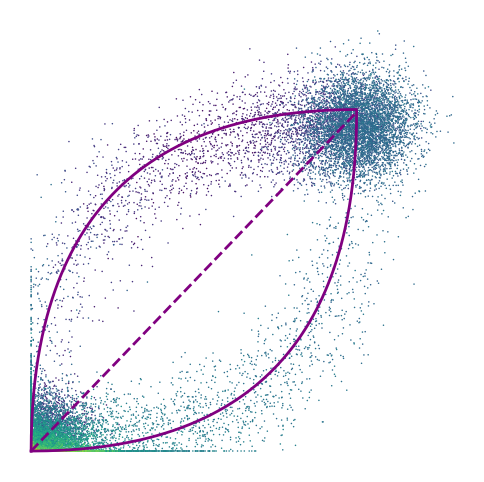

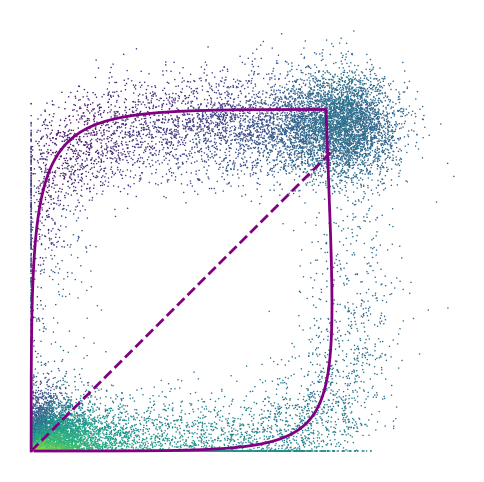

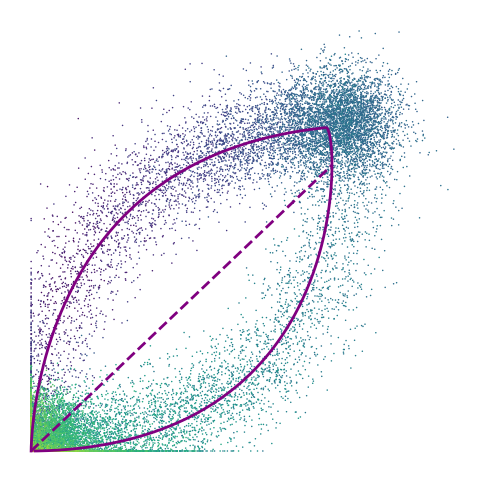

498


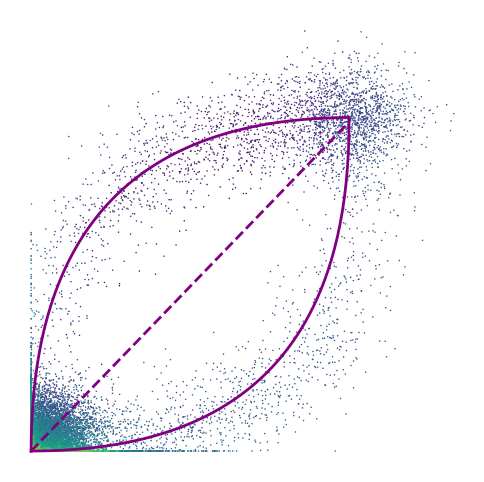

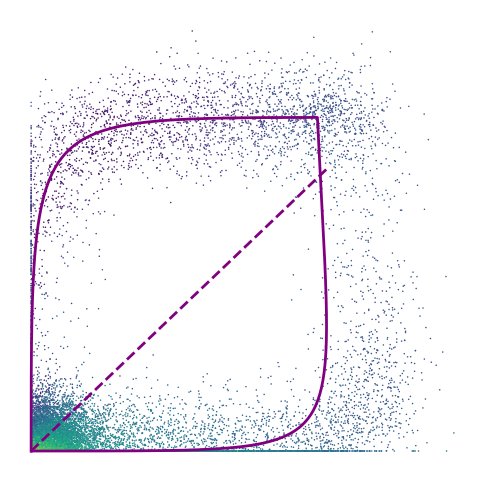

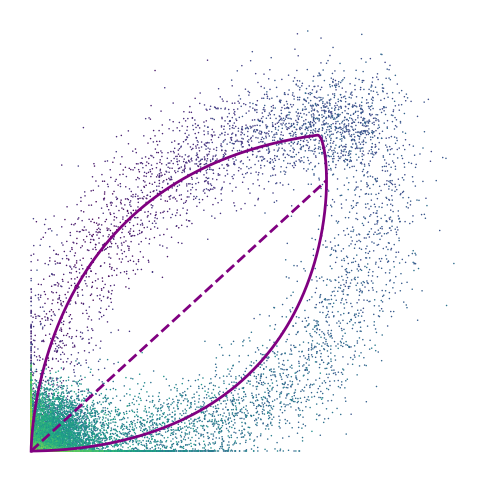

642


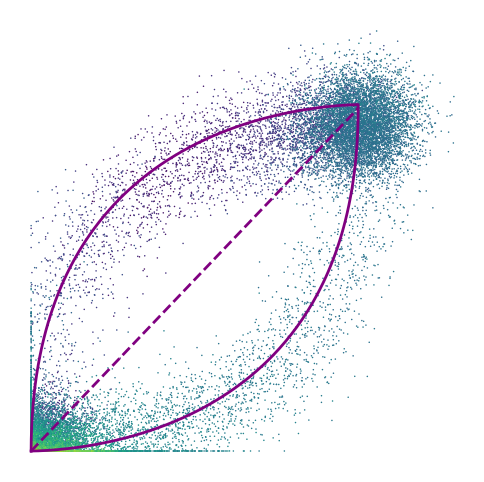

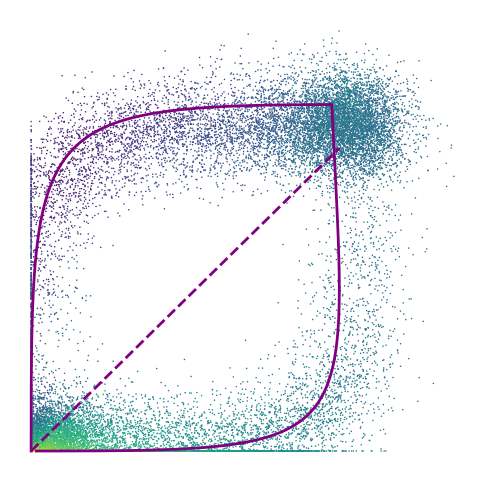

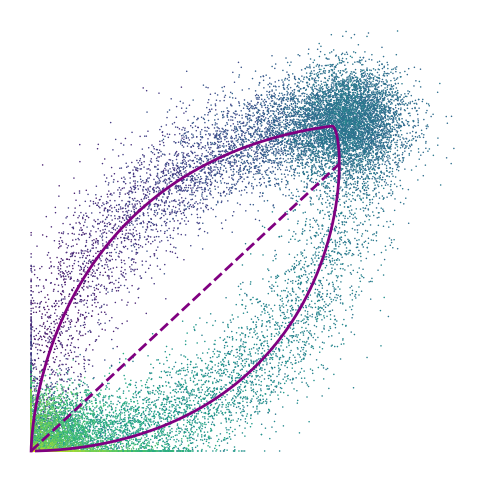

697


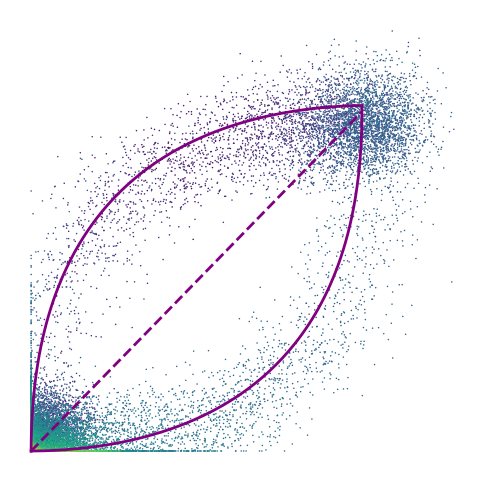

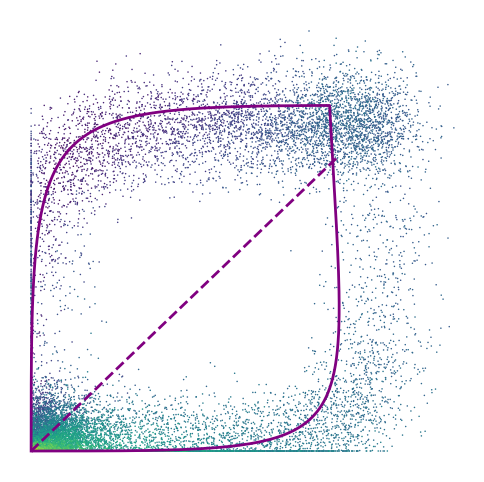

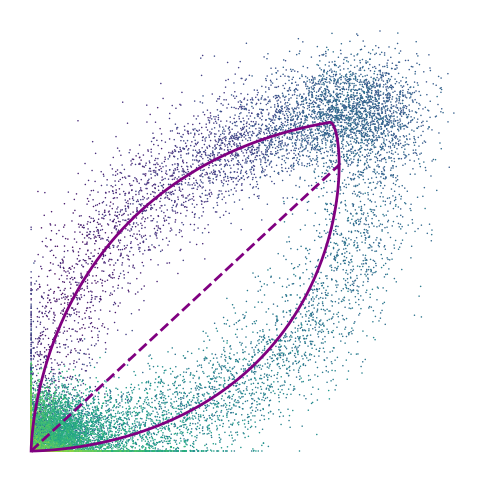

731


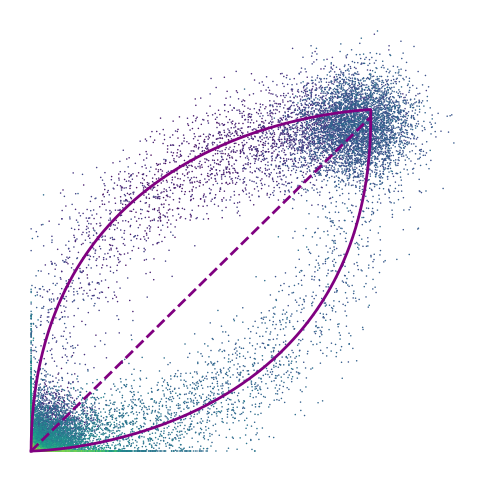

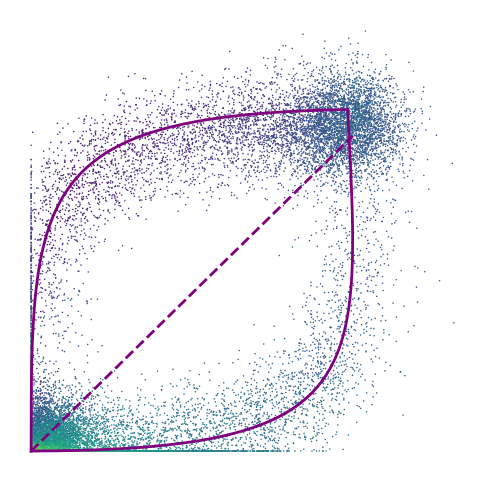

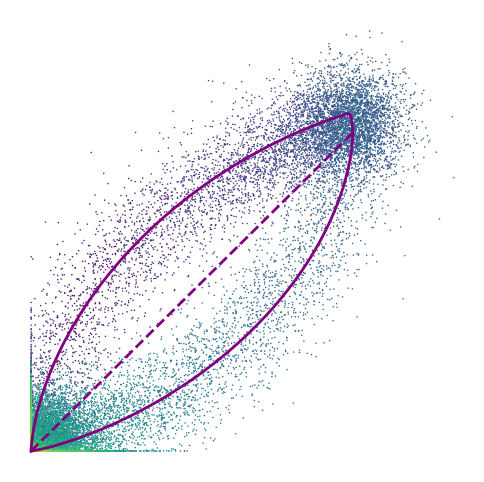

819


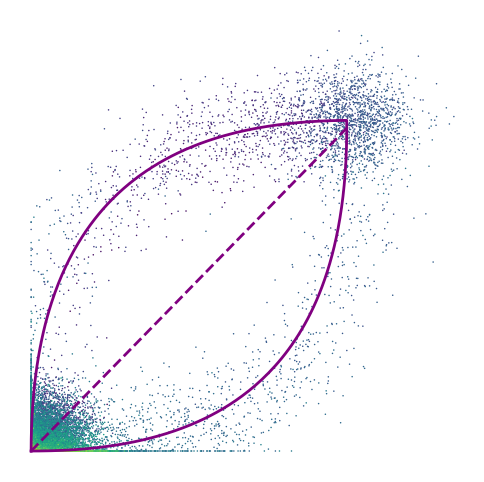

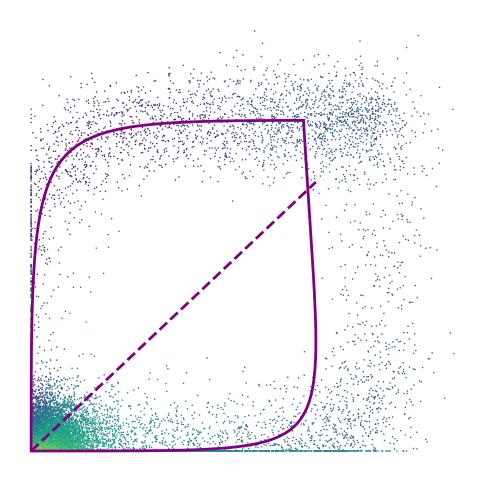

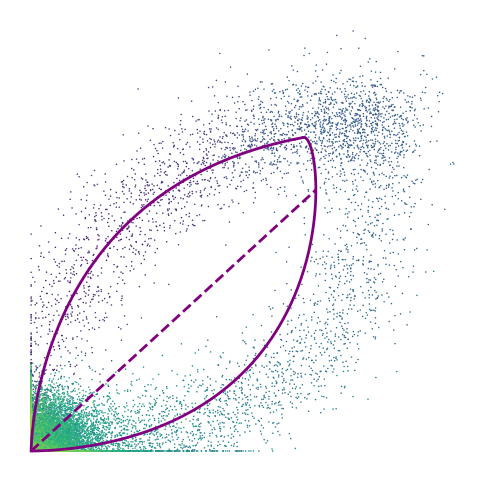

929


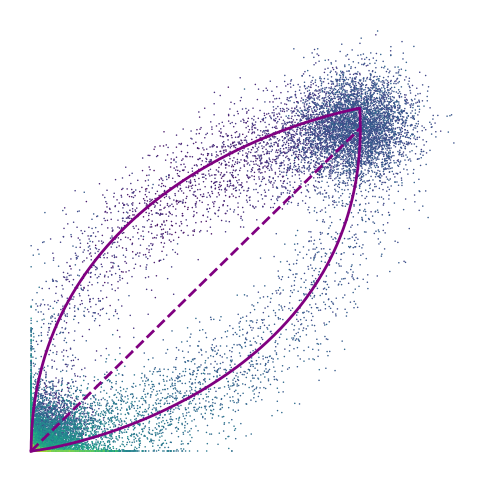

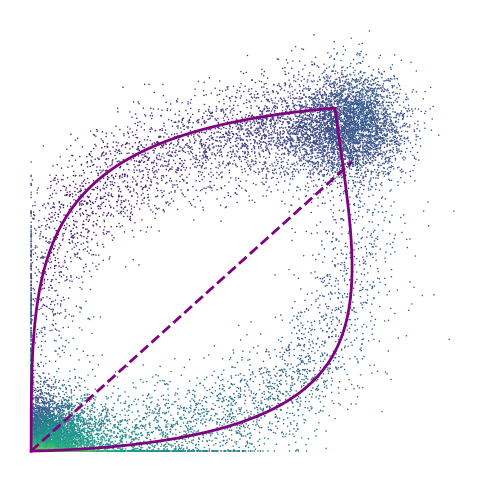

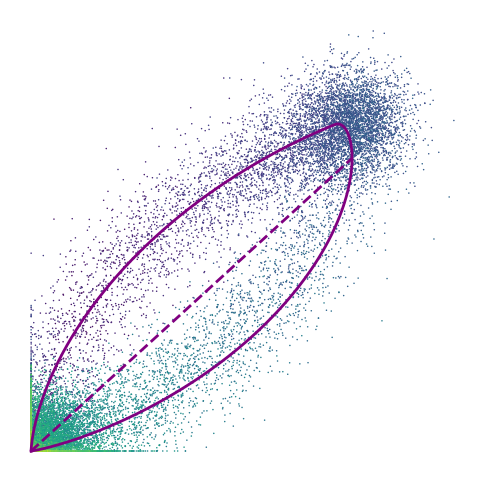

In [193]:
## Save phase portraits as .png (without axis
for gene in ad_subset.var_names[:20]:
    print(gene)
    # S_NUC vs U_NUC
    with mplscience.style_context():
        fig, ax = plt.subplots(figsize=(6, 6))

        ax = scv.pl.scatter(
            adata,
            x=adata[:, gene].layers["spliced_nucleus"],
            y=adata[:, gene].layers["unspliced_nucleus"],
            color=adata[:, gene].layers["fit_t"],
            ax=ax,
            show=False,
            colorbar=False,
        )
        ax.axis("off")

        scv.pl.plot_nuc_cyt_dynamics(ad_subset, gene, "purple", ax, "Ms_nuc", "Mu_nuc")
        plt.box(False)

        plt.show()
        if SAVE_FIGURES:
            path = FIG_DIR / "data_simulation" / "phase_portraits_good_fit"
            path.mkdir(parents=True, exist_ok=True)
            # fig.savefig(path / f"s_nuc_u_nuc_{gene}.svg", format="svg", transparent=True, bbox_inches="tight")
            fig.savefig(path / f"s_nuc_u_nuc_{gene}.png", format="png", transparent=True, bbox_inches="tight", dpi=500)

    # S_CYT vs U_NUC
    with mplscience.style_context():
        fig, ax = plt.subplots(figsize=(6, 6))

        ax = scv.pl.scatter(
            adata,
            x=adata[:, gene].layers["spliced_cytosol"],
            y=adata[:, gene].layers["unspliced_nucleus"],
            color=adata[:, gene].layers["fit_t"],
            ax=ax,
            show=False,
            colorbar=False,
        )
        ax.axis("off")
        scv.pl.plot_nuc_cyt_dynamics(ad_subset, gene, "purple", ax, "Ms_cyt", "Mu_nuc")
        plt.box(False)

        plt.show()
        if SAVE_FIGURES:
            path = FIG_DIR / "data_simulation" / "phase_portraits_good_fit"
            path.mkdir(parents=True, exist_ok=True)
            fig.savefig(path / f"s_cyt_u_nuc_{gene}.png", format="png", transparent=True, bbox_inches="tight", dpi=500)

    # S_CYT vs S_NUC
    with mplscience.style_context():
        fig, ax = plt.subplots(figsize=(6, 6))

        ax = scv.pl.scatter(
            adata,
            x=adata[:, gene].layers["spliced_cytosol"],
            y=adata[:, gene].layers["spliced_nucleus"],
            color=adata[:, gene].layers["fit_t"],
            ax=ax,
            show=False,
            colorbar=False,
        )
        ax.axis("off")
        scv.pl.plot_nuc_cyt_dynamics(ad_subset, gene, "purple", ax, "Ms_cyt", "Ms_nuc")
        plt.box(False)

        plt.show()
        if SAVE_FIGURES:
            path = FIG_DIR / "data_simulation" / "phase_portraits_good_fit"
            path.mkdir(parents=True, exist_ok=True)
            fig.savefig(path / f"s_cyt_s_nuc_{gene}.png", format="png", transparent=True, bbox_inches="tight", dpi=500)

## Boxplot of Pearson correlations between true and inferred ratio pairs

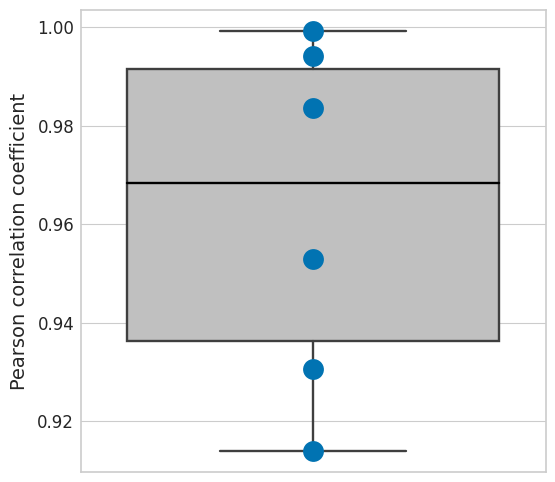

In [287]:
# Calculate pearson statistics between all (vi_ratio_xy/ true_ratio_xy) tuples
pearson_statistics = []
for var in adata.var.columns:
    if var.startswith("vi_ratio"):
        true_ratio_var = "true_ratio" + var.split("vi_ratio")[1]
        pearson_statistic = pearsonr(adata.var[var], adata.var[true_ratio_var])
        pearson_statistics.append(pearson_statistic[0])


with mplscience.style_context():
    sns.set_style(style="whitegrid")
    fig, ax = plt.subplots(figsize=(6, 6))
    sns.boxplot(
        y=pearson_statistics,
        boxprops={"facecolor": "silver"},
        medianprops={"color": "black"},
    )
    sns.swarmplot(y=pearson_statistics, color=sns.color_palette("colorblind").as_hex()[0], size=15)
    ax.set_ylabel("Pearson correlation coefficient")
    plt.show()

if SAVE_FIGURES:
    path = FIG_DIR / "data_simulation" / "rate_parameter_ratios"
    path.mkdir(parents=True, exist_ok=True)
    fig.savefig(path / "pearson_correlation_rate_ratios.svg", format="svg", transparent=True, bbox_inches="tight")

## Boxplot of Spearman Correlation of true vs. inferred time

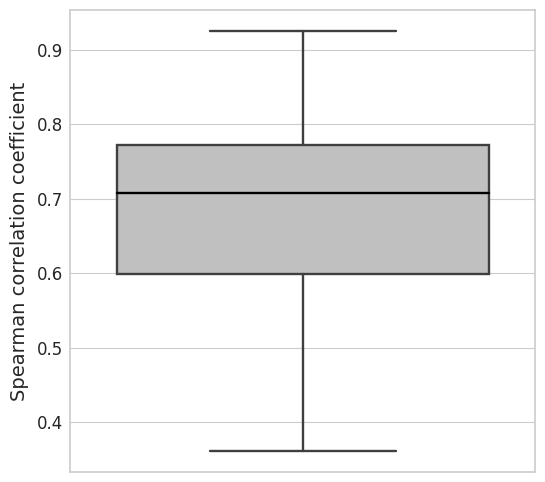

In [40]:
spearman_statistics = []
for var_id in range(adata.shape[1]):
    spearman_statistic = spearmanr(
        adata.layers["fit_t"][:, var_id] * adata[:, var_id].var["fit_alpha"].values,
        adata.obs["true_t"] * adata[:, var_id].var["true_transcription_rate"].values,
    )
    spearman_statistics.append(spearman_statistic[0])


with mplscience.style_context():
    sns.set_style(style="whitegrid")
    fig, ax = plt.subplots(figsize=(6, 6))
    sns.boxplot(
        y=spearman_statistics,
        boxprops={"facecolor": "silver"},
        medianprops={"color": "black"},
    )
    ax.set_ylabel("Spearman correlation coefficient")
    plt.show()

if SAVE_FIGURES:
    path = FIG_DIR / "data_simulation" / "rate_parameter_ratios"
    path.mkdir(parents=True, exist_ok=True)
    fig.savefig(path / "spearman_latent_time.svg", format="svg", transparent=True, bbox_inches="tight")

## Correlation of fitted switching time and true switching time

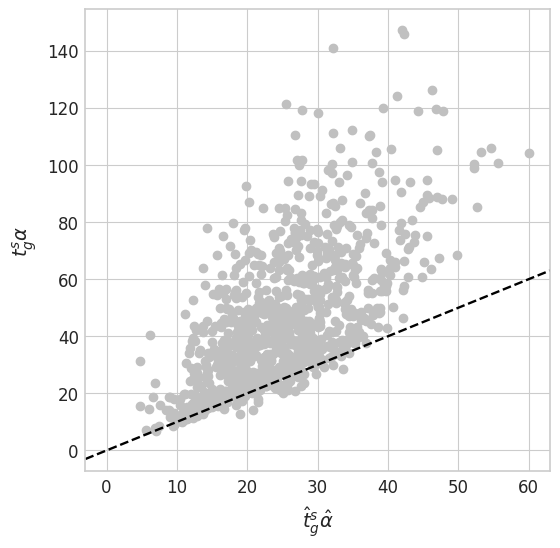

Spearman correlation of true and inferred switching times SignificanceResult(statistic=0.667943750606755, pvalue=4.394316879431117e-126) 



In [42]:
with mplscience.style_context():
    sns.set_style(style="whitegrid")
    fig, ax = plt.subplots(figsize=(6, 6))
    ax.axline((0, 0), slope=1, color="black", linestyle="--")

    ax.set_xlabel(r"$\hat{t}_g^s \hat{\alpha}$")
    ax.set_ylabel(r"$t_g^s \alpha$")

    ax.scatter(
        y=adata.var["true_t_"] * adata.var["true_transcription_rate"],
        x=adata.var["fit_t_"] * adata.var["fit_alpha"],
        c="silver",
    )
    plt.show()

print(
    "Spearman correlation of true and inferred switching times",
    spearmanr(
        adata.var["true_t_"] * adata.var["true_transcription_rate"],
        adata.var["fit_t_"] * adata.var["fit_alpha"],
    ),
    "\n",
)

if SAVE_FIGURES:
    path = FIG_DIR / "data_simulation" / "rate_parameter_ratios"
    path.mkdir(parents=True, exist_ok=True)
    fig.savefig(path / "ratio_true_time_switch.svg", format="svg", transparent=True, bbox_inches="tight")

## Plot Phase portraits with velocity streams

In [27]:
velocities = vae.get_velocity(n_samples=25, velo_statistic="mean", velo_mode="spliced_cyt")
adata.layers["velocities_velovi_s_cyt"] = velocities
velocities = vae.get_velocity(n_samples=25, velo_statistic="mean", velo_mode="spliced_nuc")
adata.layers["velocities_velovi_s_nuc"] = velocities
velocities = vae.get_velocity(n_samples=25, velo_statistic="mean", velo_mode="unspliced_nuc")
adata.layers["velocities_velovi_u_nuc"] = velocities

In [28]:
# define different velocities based on phase portrait
adata.layers["velocities_velovi_s_cyt_s_nuc"] = adata.layers["velocities_velovi_s_cyt"]
adata.layers["velocities_velovi_s_cyt_s_nuc_u"] = adata.layers["velocities_velovi_s_nuc"]

adata.layers["velocities_velovi_s_cyt_u_nuc"] = adata.layers["velocities_velovi_s_cyt"]
adata.layers["velocities_velovi_s_cyt_u_nuc_u"] = adata.layers["velocities_velovi_u_nuc"]

adata.layers["velocities_velovi_s_nuc_u_nuc"] = adata.layers["velocities_velovi_s_nuc"]
adata.layers["velocities_velovi_s_nuc_u_nuc_u"] = adata.layers["velocities_velovi_u_nuc"]

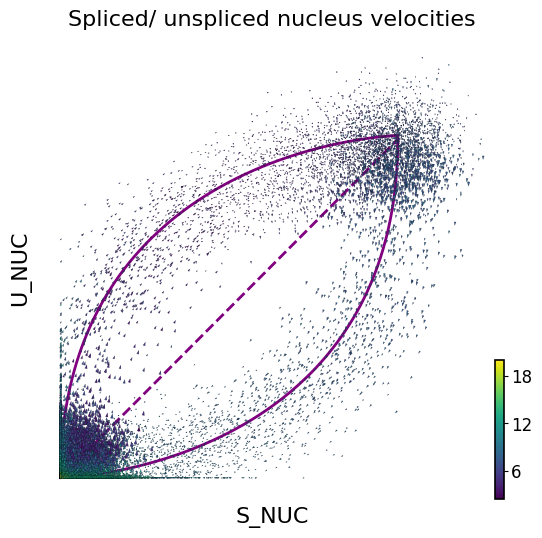

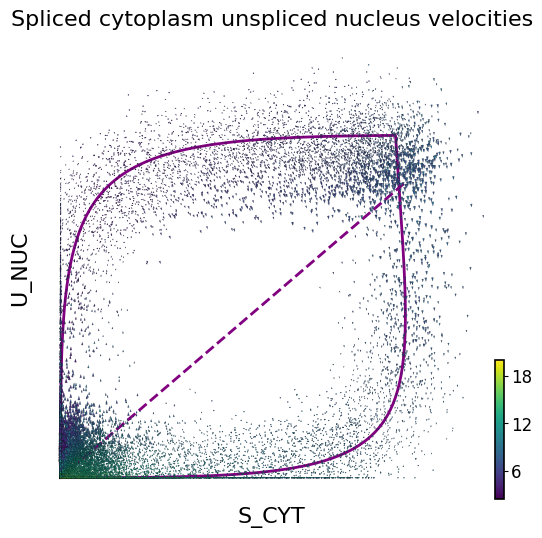

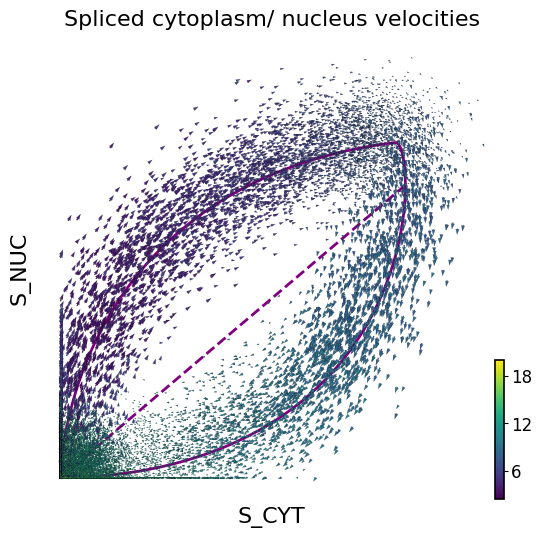

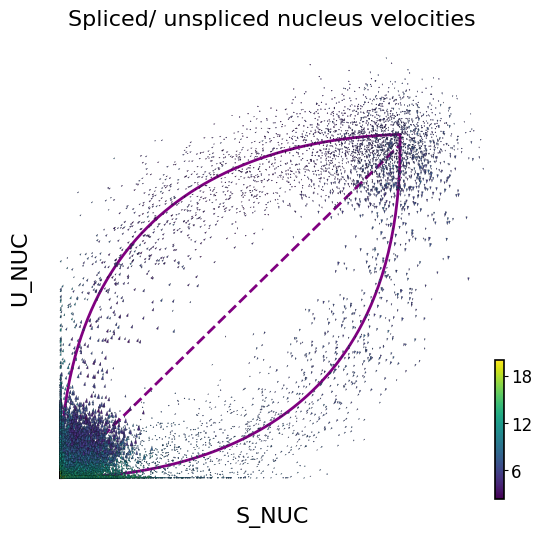

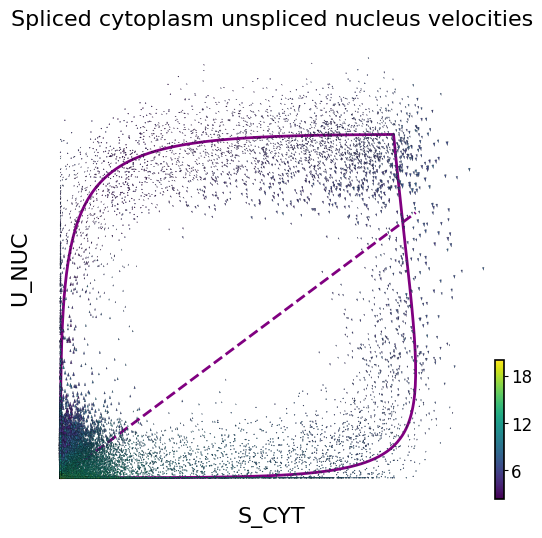

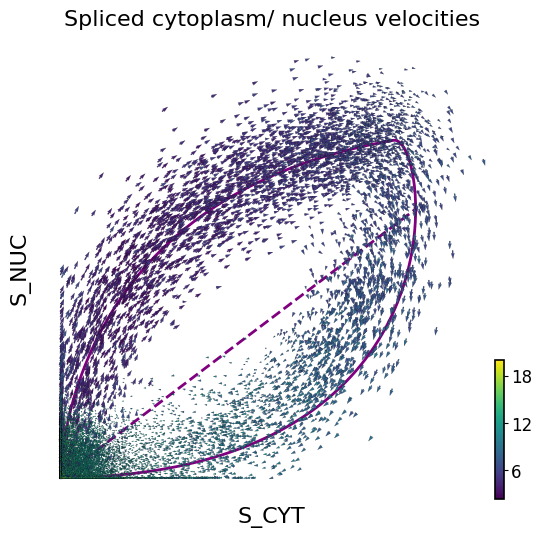

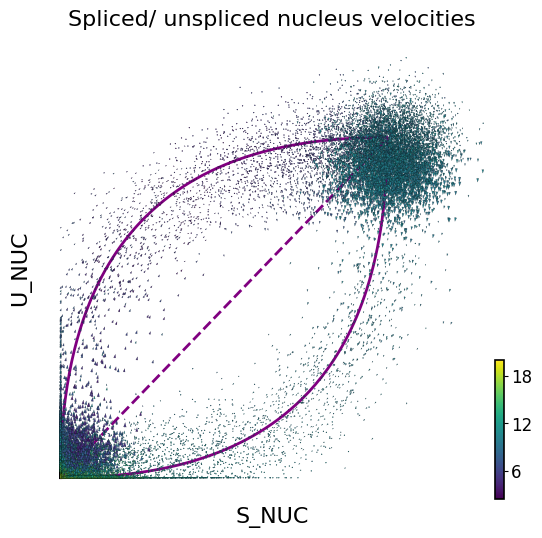

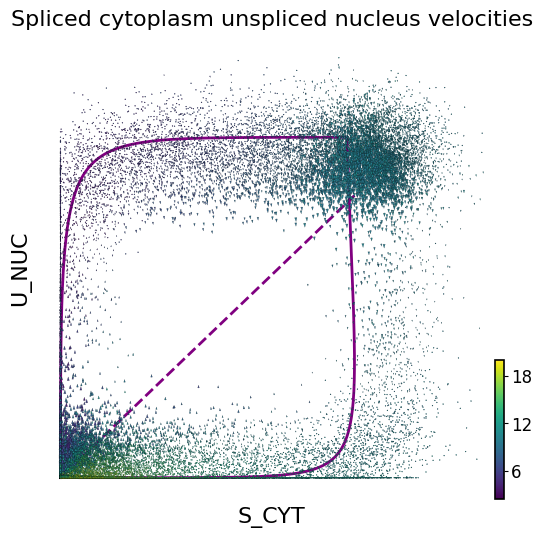

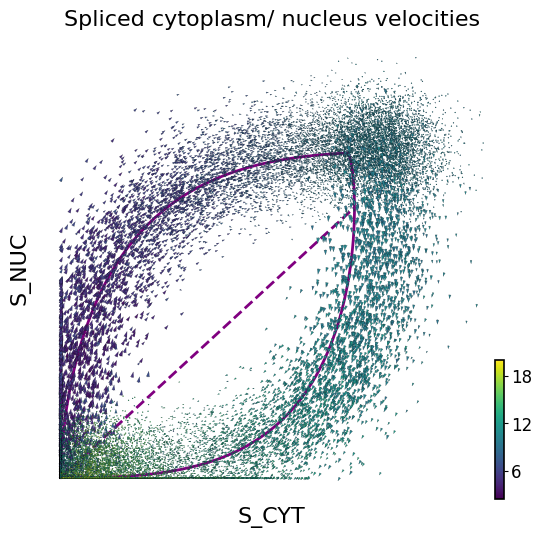

In [29]:
for gene in adata.var_names[:3]:
    # S_NUC vs U_NUC
    with mplscience.style_context():
        fig, ax = plt.subplots(figsize=(6, 6))
        # for scv.pl.velocity_embedding we need the layers "Mu" and "Ms"
        adata.layers["Ms"] = adata.layers["Ms_nuc"]
        adata.layers["Mu"] = adata.layers["Mu_nuc"]
        ax = scv.pl.velocity_embedding(
            adata,
            vkey="velocities_velovi_s_nuc_u_nuc",
            basis=gene,
            fontsize=16,
            ax=ax,
            frameon=False,
            color=adata[:, gene].layers["fit_t"],
            legend_loc="right margin",
            show=False,
            title="Spliced/ unspliced nucleus velocities",
        )
        scv.pl.plot_nuc_cyt_dynamics(adata, gene, "purple", ax, "Ms_nuc", "Mu_nuc")
        ax.set_xlabel("S_NUC")
        ax.set_ylabel("U_NUC")
        plt.show()
        if SAVE_FIGURES:
            path = FIG_DIR / "data_simulation" / "phase_portraits_velocity"
            path.mkdir(parents=True, exist_ok=True)
            fig.savefig(path / f"s_nuc_u_nuc_{gene}.svg", format="svg", transparent=True, bbox_inches="tight")

    # S_CYT vs U_NUC
    with mplscience.style_context():
        fig, ax = plt.subplots(figsize=(6, 6))
        # for scv.pl.velocity_embedding we need the layers "Mu" and "Ms"
        adata.layers["Ms"] = adata.layers["Ms_cyt"]
        adata.layers["Mu"] = adata.layers["Mu_nuc"]
        ax = scv.pl.velocity_embedding(
            adata,
            vkey="velocities_velovi_s_cyt_u_nuc",
            basis=gene,
            fontsize=16,
            ax=ax,
            frameon=False,
            color=adata[:, gene].layers["fit_t"],
            legend_loc="right margin",
            show=False,
            title="Spliced cytoplasm unspliced nucleus velocities",
        )
        scv.pl.plot_nuc_cyt_dynamics(adata, gene, "purple", ax, "Ms_cyt", "Mu_nuc")
        ax.set_xlabel("S_CYT")
        ax.set_ylabel("U_NUC")
        plt.show()
        if SAVE_FIGURES:
            path = FIG_DIR / "data_simulation" / "phase_portraits_velocity"
            path.mkdir(parents=True, exist_ok=True)
            fig.savefig(path / f"s_cyt_u_nuc_{gene}.svg", format="svg", transparent=True, bbox_inches="tight")

    # S_CYT vs S_NUC
    with mplscience.style_context():
        fig, ax = plt.subplots(figsize=(6, 6))
        # for scv.pl.velocity_embedding we need the layers "Mu" and "Ms"
        adata.layers["Ms"] = adata.layers["Ms_cyt"]
        adata.layers["Mu"] = adata.layers["Ms_nuc"]
        ax = scv.pl.velocity_embedding(
            adata,
            vkey="velocities_velovi_s_cyt_s_nuc",
            basis=gene,
            fontsize=16,
            ax=ax,
            frameon=False,
            color=adata[:, gene].layers["fit_t"],
            legend_loc="right margin",
            show=False,
            title="Spliced cytoplasm/ nucleus velocities",
        )
        scv.pl.plot_nuc_cyt_dynamics(adata, gene, "purple", ax, "Ms_cyt", "Ms_nuc")
        ax.set_xlabel("S_CYT")
        ax.set_ylabel("S_NUC")
        plt.show()
        if SAVE_FIGURES:
            path = FIG_DIR / "data_simulation" / "phase_portraits_velocity"
            path.mkdir(parents=True, exist_ok=True)
            fig.savefig(path / f"s_cyt_s_nuc_{gene}.svg", format="svg", transparent=True, bbox_inches="tight")

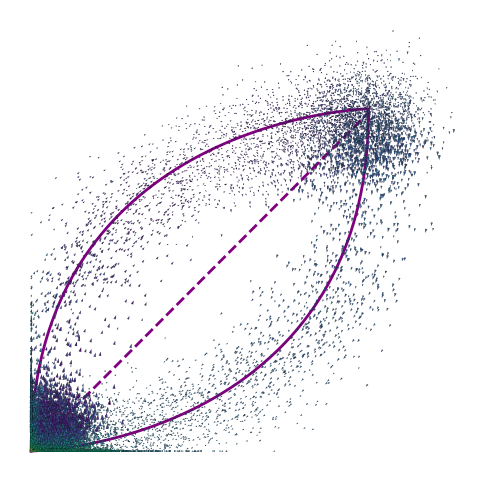

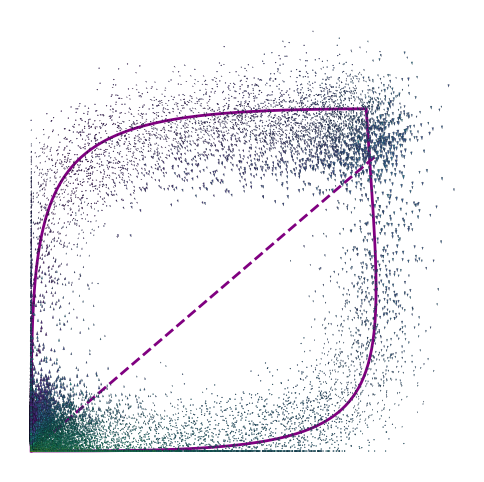

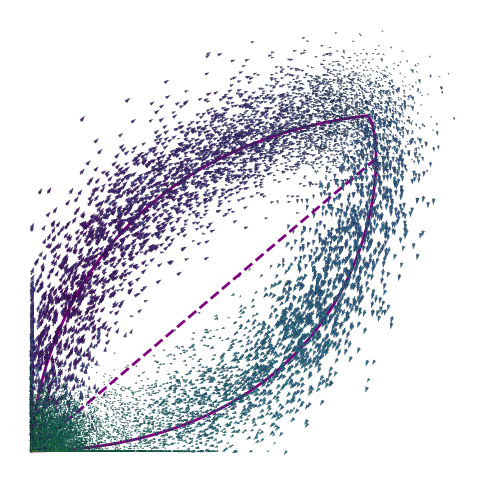

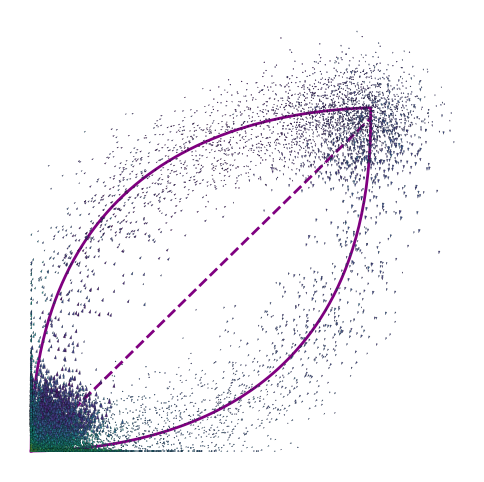

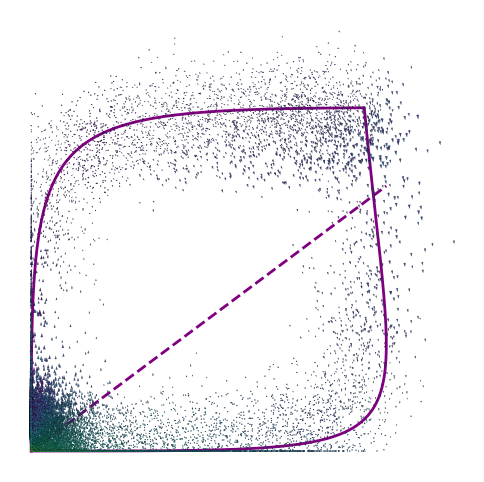

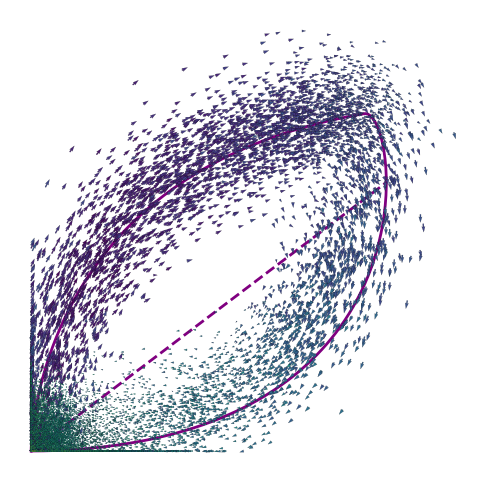

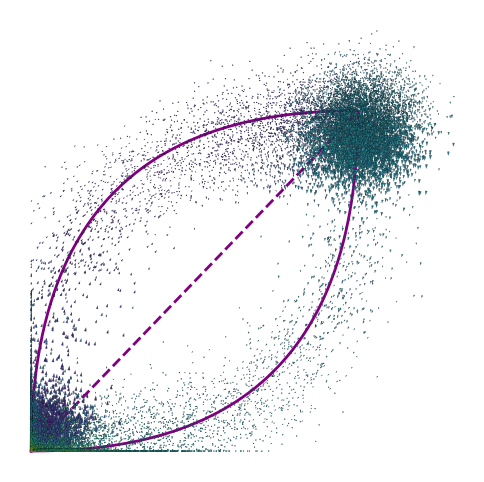

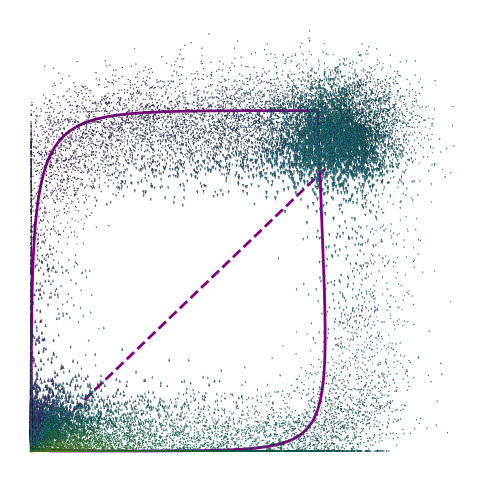

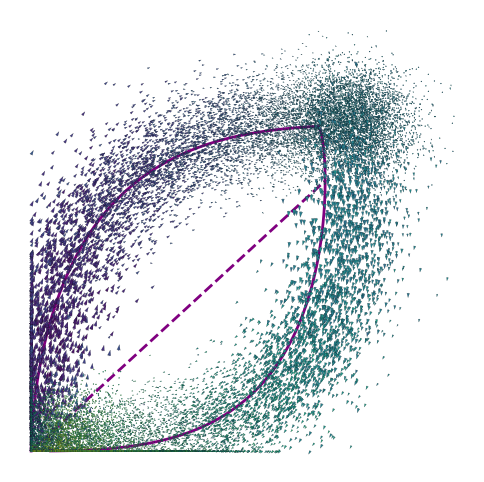

In [30]:
for gene in adata.var_names[:3]:
    # S_NUC vs U_NUC
    with mplscience.style_context():
        fig, ax = plt.subplots(figsize=(6, 6))
        # for scv.pl.velocity_embedding we need the layers "Mu" and "Ms"
        adata.layers["Ms"] = adata.layers["Ms_nuc"]
        adata.layers["Mu"] = adata.layers["Mu_nuc"]
        ax = scv.pl.velocity_embedding(
            adata,
            vkey="velocities_velovi_s_nuc_u_nuc",
            basis=gene,
            fontsize=16,
            ax=ax,
            frameon=False,
            color=adata[:, gene].layers["fit_t"],
            legend_loc="right margin",
            show=False,
            title="",
            colorbar=False,
        )
        scv.pl.plot_nuc_cyt_dynamics(adata, gene, "purple", ax, "Ms_nuc", "Mu_nuc")
        ax.axis("off")
        plt.box(False)

        plt.show()
        if SAVE_FIGURES:
            path = FIG_DIR / "data_simulation" / "phase_portraits_velocity"
            path.mkdir(parents=True, exist_ok=True)
            fig.savefig(path / f"s_nuc_u_nuc_{gene}.png", format="png", transparent=True, bbox_inches="tight", dpi=500)

    # S_CYT vs U_NUC
    with mplscience.style_context():
        fig, ax = plt.subplots(figsize=(6, 6))
        # for scv.pl.velocity_embedding we need the layers "Mu" and "Ms"
        adata.layers["Ms"] = adata.layers["Ms_cyt"]
        adata.layers["Mu"] = adata.layers["Mu_nuc"]
        ax = scv.pl.velocity_embedding(
            adata,
            vkey="velocities_velovi_s_cyt_u_nuc",
            basis=gene,
            fontsize=16,
            ax=ax,
            frameon=False,
            color=adata[:, gene].layers["fit_t"],
            legend_loc="right margin",
            show=False,
            title="",
            colorbar=False,
        )
        scv.pl.plot_nuc_cyt_dynamics(adata, gene, "purple", ax, "Ms_cyt", "Mu_nuc")
        ax.axis("off")
        plt.box(False)
        plt.show()
        if SAVE_FIGURES:
            path = FIG_DIR / "data_simulation" / "phase_portraits_velocity"
            path.mkdir(parents=True, exist_ok=True)
            fig.savefig(path / f"s_cyt_u_nuc_{gene}.png", format="png", transparent=True, bbox_inches="tight", dpi=500)

    # S_CYT vs S_NUC
    with mplscience.style_context():
        fig, ax = plt.subplots(figsize=(6, 6))
        # for scv.pl.velocity_embedding we need the layers "Mu" and "Ms"
        adata.layers["Ms"] = adata.layers["Ms_cyt"]
        adata.layers["Mu"] = adata.layers["Ms_nuc"]
        ax = scv.pl.velocity_embedding(
            adata,
            vkey="velocities_velovi_s_cyt_s_nuc",
            basis=gene,
            fontsize=16,
            ax=ax,
            frameon=False,
            color=adata[:, gene].layers["fit_t"],
            legend_loc="right margin",
            show=False,
            title="",
            colorbar=False,
        )
        scv.pl.plot_nuc_cyt_dynamics(adata, gene, "purple", ax, "Ms_cyt", "Ms_nuc")
        plt.box(False)
        plt.show()
        if SAVE_FIGURES:
            path = FIG_DIR / "data_simulation" / "phase_portraits_velocity"
            path.mkdir(parents=True, exist_ok=True)
            fig.savefig(path / f"s_cyt_s_nuc_{gene}.png", format="png", transparent=True, bbox_inches="tight", dpi=500)

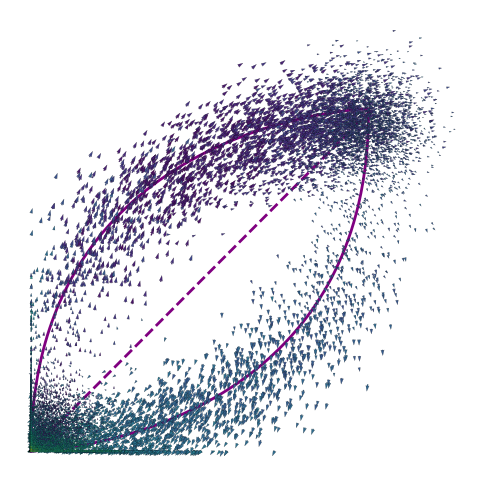

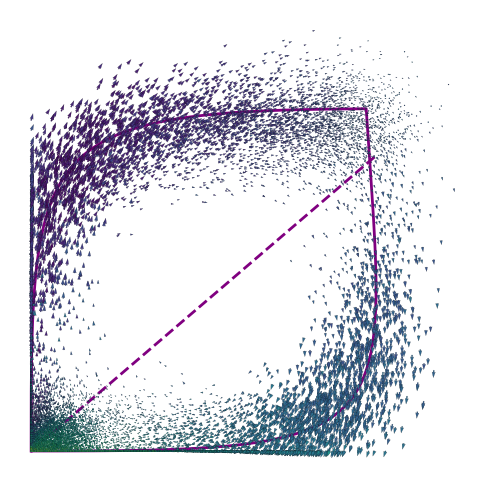

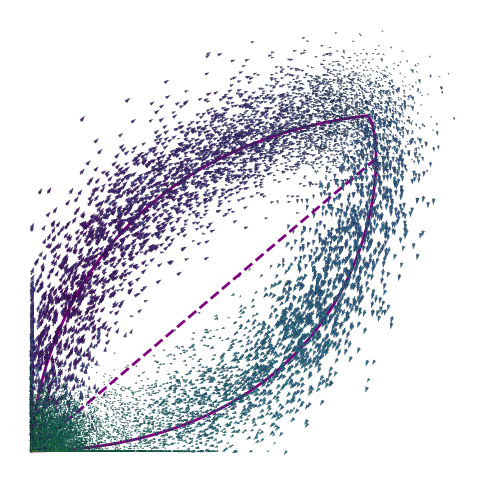

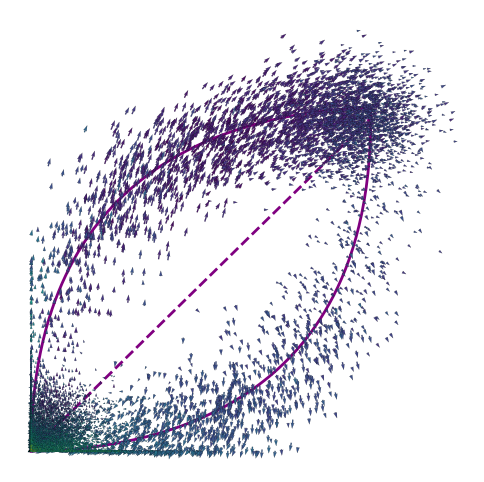

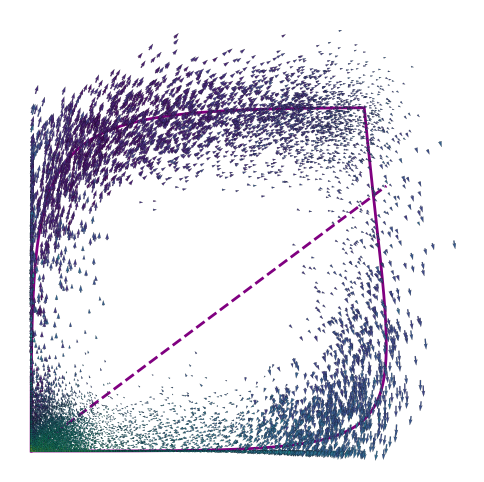

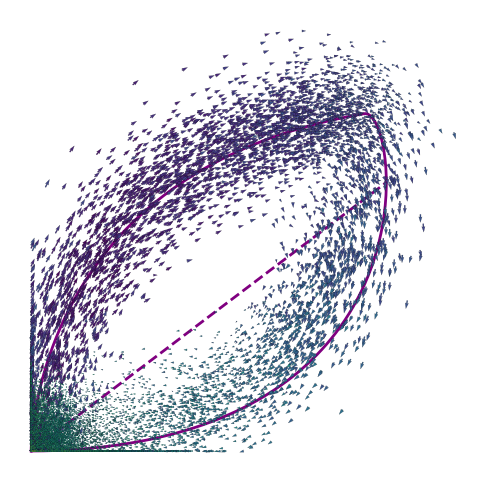

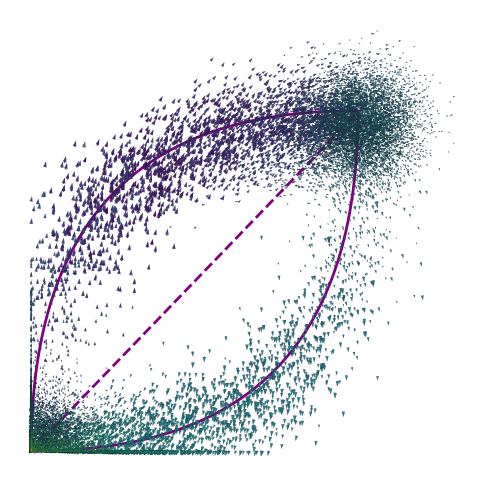

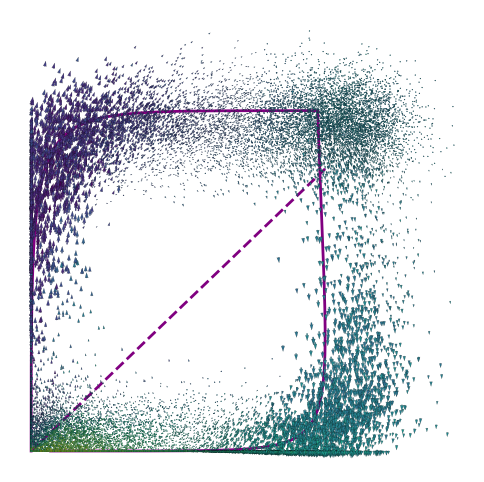

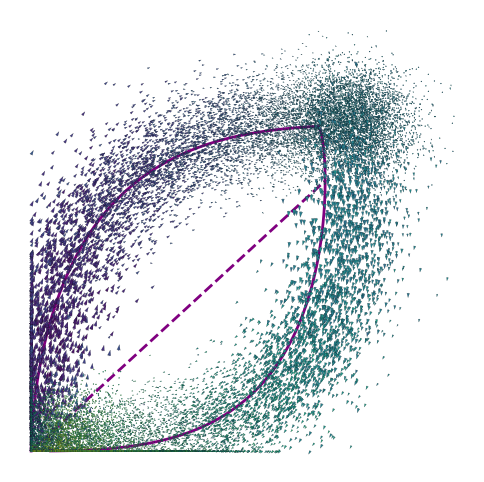

In [33]:
for gene in adata.var_names[:3]:
    # S_NUC vs U_NUC
    with mplscience.style_context():
        fig, ax = plt.subplots(figsize=(6, 6))
        # for scv.pl.velocity_embedding we need the layers "Mu" and "Ms"
        adata.layers["Ms"] = adata.layers["Ms_nuc"]
        adata.layers["Mu"] = adata.layers["Mu_nuc"]
        ax = scv.pl.velocity_embedding(
            adata,
            vkey="velocities_velovi_s_cyt_s_nuc",
            basis=gene,
            fontsize=16,
            ax=ax,
            frameon=False,
            color=adata[:, gene].layers["fit_t"],
            legend_loc="right margin",
            show=False,
            title="",
            colorbar=False,
        )
        scv.pl.plot_nuc_cyt_dynamics(adata, gene, "purple", ax, "Ms_nuc", "Mu_nuc")
        ax.axis("off")
        plt.box(False)

        plt.show()
        if SAVE_FIGURES:
            path = FIG_DIR / "data_simulation" / "phase_portraits_velocity"
            path.mkdir(parents=True, exist_ok=True)
            fig.savefig(path / f"s_nuc_u_nuc_{gene}.png", format="png", transparent=True, bbox_inches="tight", dpi=500)

    # S_CYT vs U_NUC
    with mplscience.style_context():
        fig, ax = plt.subplots(figsize=(6, 6))
        # for scv.pl.velocity_embedding we need the layers "Mu" and "Ms"
        adata.layers["Ms"] = adata.layers["Ms_cyt"]
        adata.layers["Mu"] = adata.layers["Mu_nuc"]
        ax = scv.pl.velocity_embedding(
            adata,
            vkey="velocities_velovi_s_cyt_s_nuc",
            basis=gene,
            fontsize=16,
            ax=ax,
            frameon=False,
            color=adata[:, gene].layers["fit_t"],
            legend_loc="right margin",
            show=False,
            title="",
            colorbar=False,
        )
        scv.pl.plot_nuc_cyt_dynamics(adata, gene, "purple", ax, "Ms_cyt", "Mu_nuc")
        ax.axis("off")
        plt.box(False)
        plt.show()
        if SAVE_FIGURES:
            path = FIG_DIR / "data_simulation" / "phase_portraits_velocity"
            path.mkdir(parents=True, exist_ok=True)
            fig.savefig(path / f"s_cyt_u_nuc_{gene}.png", format="png", transparent=True, bbox_inches="tight", dpi=500)

    # S_CYT vs S_NUC
    with mplscience.style_context():
        fig, ax = plt.subplots(figsize=(6, 6))
        # for scv.pl.velocity_embedding we need the layers "Mu" and "Ms"
        adata.layers["Ms"] = adata.layers["Ms_cyt"]
        adata.layers["Mu"] = adata.layers["Ms_nuc"]
        ax = scv.pl.velocity_embedding(
            adata,
            vkey="velocities_velovi_s_cyt_s_nuc",
            basis=gene,
            fontsize=16,
            ax=ax,
            frameon=False,
            color=adata[:, gene].layers["fit_t"],
            legend_loc="right margin",
            show=False,
            title="",
            colorbar=False,
        )
        scv.pl.plot_nuc_cyt_dynamics(adata, gene, "purple", ax, "Ms_cyt", "Ms_nuc")
        plt.box(False)
        plt.show()
        if SAVE_FIGURES:
            path = FIG_DIR / "data_simulation" / "phase_portraits_velocity"
            path.mkdir(parents=True, exist_ok=True)
            fig.savefig(path / f"s_cyt_s_nuc_{gene}.png", format="png", transparent=True, bbox_inches="tight", dpi=500)